# Sepsis Classification using Machine Learning

## 1.0  Business Understanding 💼

### 1.1 Introuction

### 1.1.1 Sepsis Overview
Sepsis, a life-threatening condition, arises from the body’s exaggerated response to infection. Swift intervention is essential to prevent tissue damage, organ failure, and mortality because septic shock can cause death in as little as 12 hours. Therefore, Prompt diagnosis and treatment significantly enhance survival rates for individuals with mild sepsis. Conversely, without timely intervention, advanced stages of sepsis often prove fatal. Even with optimal care, septic shock—the most critical phase of sepsis—has a mortality rate of 30% to 40%.

### 1.1.2 High-Risk Groups

`Broad Impact:` Sepsis can strike anyone, but certain populations face elevated risks.

`Vulnerable Individuals:`

- Elderly: Those aged 60 and older.
- Newborns and Infants: Their developing immune systems make them susceptible.
- Pregnant Individuals: Hormonal changes increase vulnerability.
- Medical Conditions: Diabetes, obesity, cancer, and kidney disease heighten risk.
- Weakened Immune Systems: Immunocompromised individuals.
- Hospitalized Patients: Especially those with existing medical issues.
- Trauma Patients: Severe injuries, such as burns or wounds.
- Medical Devices: Catheters, IVs, and breathing tubes.

`Diagnosing Sepsis`

- Challenges in Diagnosis: No rigid criteria exist for sepsis diagnosis.
- Holistic Approach: Providers combine various assessments:
    - Clinical Examination: Physical exam findings.
    - Laboratory Tests: Blood cultures to identify the infection.
    - qSOFA Criteria: Quick Sequential Organ Failure Assessment.

`Indicators of Sepsis:`

- Low Blood Pressure: Systolic BP < 100 mmHg.
- High Respiratory Rate: > 22 breaths per minute.

`Additional Tests:`

- Blood Tests: Complete blood count (CBC), liver and kidney function tests, clotting assessments, and electrolyte levels.
- Blood Oxygen Level: Evaluates blood oxygenation.
- Urine Tests: Urinalysis and urine culture.
- Imaging: X-rays or CT scans.

### 1.2 Project Overview

Sepsis is a life-threatening medical emergency. `Early detection` is crucial to prevent severe consequences. By implementing a machine learning solution integrated with FastAPI, healthcare professionals will have a powerful tool to predict sepsis, improving patient outcomes and reducing mortality rates. This project aligns with our strategic goals of leveraging advanced analytics and machine learning to improve operational efficiency in healthcare.

### 1.3 Key Objectives
    
`Early Detection:` Predict which patients in the ICU are likely to develop sepsis, allowing healthcare providers to intervene early and improve patient outcomes.

`Resource Allocation: `Optimize the allocation of medical resources by focusing attention and care on high-risk patients.
 
`Reduce Healthcare Costs:` Early detection and treatment of sepsis can decrease hospital stays and reduce the need for intensive care, leading to substantial cost savings.

`Improve Operational Efficiency:` Automating sepsis prediction through advanced machine learning models reduces the burden on healthcare professionals, allowing them to focus on patient care.

### 1.4 About Data
The dataset is a modified version of a publicly available data source from Johns Hopkins University hosted on Kaggle. 

### 1.5 Key Stakeholders

`Healthcare Professionals`

- `Physicians and Surgeons:` Utilize the sepsis prediction tool to make timely and accurate clinical decisions.
- `Nurses and Caregivers:` Implement the intervention strategies based on predictions, providing frontline patient care.
- `Clinical Researchers:` Validate and refine the predictive model, ensuring its clinical relevance and accuracy.

`Hospital Administration`

- `Chief Medical Officer (CMO):` Oversees the clinical effectiveness of the solution and its alignment with patient care standards.
- `Chief Nursing Officer (CNO):` Ensures the tool enhances nursing workflows and improves patient care quality.
- `Chief Information Officer (CIO):` Manages the integration of the solution with hospital IT systems and ensures data security and compliance.

`Technical Team`

- `Data Scientists and Machine Learning Engineers:` Develop and refine the predictive models, ensuring their accuracy and reliability.
- `Software Developers:` Implement the FastAPI application and ensure its seamless integration with hospital systems.
- `IT Support Staff:` Provide ongoing technical support and maintenance for the deployed solution.

`Compliance and Regulatory Bodies`

- `Healthcare Compliance Officers:` Ensure the solution adheres to healthcare regulations such as HIPAA.
- `Quality Assurance Teams:` Monitor the system's performance and ensure it meets regulatory standards and quality benchmarks.

`Patients and Patient Advocacy Groups`

- `Patients:` Direct beneficiaries of the solution, experiencing improved outcomes due to early sepsis detection.
- `Patient Advocacy Groups:` Represent patient interests, ensuring the solution is user-friendly and accessible, and provides tangible benefits to patient care.

`Financial Stakeholders`

- `Chief Financial Officer (CFO):` Evaluates the financial implications of implementing the solution, including cost savings from reduced hospital stays and improved patient outcomes.
- `Investors and Funders:` Provide the necessary funding and resources to support the development and deployment of the solution.


### 1.6 Hypothesis

**Hypothesis 1:** Age and Sepsis

`Null Hypothesis(Ho):` Older patients (age 60 and above) are less likely to develop sepsis compared to younger patients (below 60 years)

`Alternate Hypothesis(Ha):` Older patients (age 60 and above) are more likely to develop sepsis compared to younger patients (below 60 years)


**Hypothesis 2:** Plasma levels and Sepsis

`Null Hypothesis(Ho):` There is no significant relationship between plasma levels and the occurrence of sepsis.

`Alternate Hypothesis(Ha):` A significant relationship exists between plasma levels and the occurrence of sepsis.



### 1.7 Analytical Questions
1. Is there a relationship between body mass index (M11) and the development of sepsis?
 
2. Are there noticeable differences in blood pressure (PR) readings between sepsis-positive and sepsis-negative patients?

3. What is the correlation between plasma levels and the prevalence of sepsis?
 
4. How do plasma glucose levels (PRG) differ between patients who develop sepsis and those who do not?

5. How does Body Mass Index (BMI) affect the incidence of sepsis?

6. What is the average/median age of patients who develop sepsis and those without sepsis?

7. Which blood pressure levels are most strongly associated with the development of sepsis?

8. Are insured patients more or less susceptible to sepsis?

### 1.8 Success Criteria
- `Clinical Accuracy:` The model should demonstrate high accuracy (e.g., both F1 score and AUC_ROC score are above 0.80) in predicting sepsis based on historical patient data.
- `Operational Integration:` The FastAPI application should seamlessly integrate with hospital electronic health records (EHR) systems, providing real-time predictions with minimal latency.
- `User Adoption:` High adoption rates among healthcare professionals, indicating the tool's usability and effectiveness in a clinical setting.
- `Cost Savings:` Quantifiable reduction in healthcare costs associated with sepsis treatment and extended hospital stays.

## 2.0 Data Understanding 🔍

- Set the base directory

### 2.1 Prerequisites- Import needed packages

In [35]:
# Os packages
import os
from pathlib import Path

# Environmental variables
from dotenv import dotenv_values 

# Data handling
import numpy as np
import pandas as pd 

# Type hinting
from typing import Dict, List, Union

# Visualization
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff
import kaleido
import webp
from IPython.display import display
import plotly.io as pio
pio.renderers.default = 'vscode+plotly_mimetype+png' # Set default renderers for plotly
INTERACTIVE = False  # False, Display on plots as webp and render to display, works on GitHub. Set to True to use dynamic plots in supported environments

# Statistical tests
from scipy.stats import mannwhitneyu, chi2_contingency

# PCA 
from sklearn.decomposition import PCA

# Feature Processing
from utils.pipeline_helper import *

from sklearn.impute import SimpleImputer
from sklearn.feature_selection import mutual_info_classif, SelectKBest  # Univariate Selection using KBest
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.preprocessing import RobustScaler, LabelEncoder, OneHotEncoder, FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as imPipeline
from imblearn.over_sampling import SMOTE # Balance class distribution

# Modelling
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from catboost import CatBoostClassifier
import lightgbm as lgb
from xgboost import XGBClassifier
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier

# Save model
import joblib
from huggingface_hub import notebook_login
from skops import card, hub_utils

# Evaluation - Cross Validation & Hyperparameters Fine-tuning 
from sklearn.metrics import f1_score, confusion_matrix, classification_report, roc_curve, auc

# Set pandas to display all columns
pd.set_option("display.max_columns", None)

# Suppress the scientific notation
pd.set_option("display.float_format", lambda x: '%.2f' % x)

# Disable warnings               
import warnings
warnings.filterwarnings('ignore')


if kaleido.__version__!='0.1.0.post1':
    # pip install kaleido==0.1.0post1
    print('Kaleido version may not work properly. Version 0.1.0.post1 is supported')


print("🛬 Imported all packages.", "Warnings hidden. 👻")

🛬 Imported all packages. Warnings hidden. 👻


### 2.2 Data reading

In [36]:
BASE_DIR = '../'
TEST_FILE = os.path.join(BASE_DIR, 'data/Paitients_Files_Test.csv')
TEST_FILE_URL = "https://raw.githubusercontent.com/D0nG4667/sepsis_prediction_full_stack/main/dev/data/Paitients_Files_Test.csv"
TRAIN_FILE = os.path.join(BASE_DIR, 'data/Paitients_Files_Train.csv')
TRAIN_FILE_URL = "https://raw.githubusercontent.com/D0nG4667/sepsis_prediction_full_stack/main/dev/data/Paitients_Files_Train.csv"
PLOTS = os.path.join(BASE_DIR, 'plots/')
SAVE_MODELS = os.path.join(BASE_DIR, 'models/')

In [37]:
# Load environment variables from .env file into a dictionary
ENV_FILE = '../../env/notebook.env'
environment_variables = dotenv_values(ENV_FILE)

# Get the hugginface token file path that you set in the '.env' file
TOKEN_FILE = environment_variables.get("TOKEN_FILE")

### 2.2.1 Test Dataset

In [38]:
# Read the flat file
try:
    df_test = pd.read_csv(TEST_FILE_URL)
except Exception as e:
    df_test = pd.read_excel(TEST_FILE)

In [5]:
df_test.head()

,ID,PRG,PL,PR,SK,TS,M11,BD2,Age,Insurance
0,ICU200609,1,109,38,18,120,23.10,0.41,26,1
1,ICU200610,1,108,88,19,0,27.10,0.40,24,1
2,ICU200611,6,96,0,0,0,23.70,0.19,28,1
3,ICU200612,1,124,74,36,0,27.80,0.10,30,1
4,ICU200613,7,150,78,29,126,35.20,0.69,54,0


In [6]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169 entries, 0 to 168
Data columns (total 10 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         169 non-null    object 
 1   PRG        169 non-null    int64  
 2   PL         169 non-null    int64  
 3   PR         169 non-null    int64  
 4   SK         169 non-null    int64  
 5   TS         169 non-null    int64  
 6   M11        169 non-null    float64
 7   BD2        169 non-null    float64
 8   Age        169 non-null    int64  
 9   Insurance  169 non-null    int64  
dtypes: float64(2), int64(7), object(1)
memory usage: 13.3+ KB


### 2.2.2 Train Dataset

In [39]:
# Read the flat file
try:
    df_train = pd.read_csv(TRAIN_FILE_URL)
except Exception as e:
    df_train = pd.read_csv(TRAIN_FILE)

In [8]:
df_train.head()

,ID,PRG,PL,PR,SK,TS,M11,BD2,Age,Insurance,Sepssis
0,ICU200010,6,148,72,35,0,33.60,0.63,50,0,Positive
1,ICU200011,1,85,66,29,0,26.60,0.35,31,0,Negative
2,ICU200012,8,183,64,0,0,23.30,0.67,32,1,Positive
3,ICU200013,1,89,66,23,94,28.10,0.17,21,1,Negative
4,ICU200014,0,137,40,35,168,43.10,2.29,33,1,Positive


In [9]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 599 entries, 0 to 598
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         599 non-null    object 
 1   PRG        599 non-null    int64  
 2   PL         599 non-null    int64  
 3   PR         599 non-null    int64  
 4   SK         599 non-null    int64  
 5   TS         599 non-null    int64  
 6   M11        599 non-null    float64
 7   BD2        599 non-null    float64
 8   Age        599 non-null    int64  
 9   Insurance  599 non-null    int64  
 10  Sepssis    599 non-null    object 
dtypes: float64(2), int64(7), object(2)
memory usage: 51.6+ KB


In [10]:
df_train.isna().sum()

ID           0
PRG          0
PL           0
PR           0
SK           0
TS           0
M11          0
BD2          0
Age          0
Insurance    0
Sepssis      0
dtype: int64

In [11]:
df_train.duplicated().sum()

0

### 2.2.3 Data Dictionary

| Column   Name                | Attribute/Target | Description                                                                                                                                                                                                  |
|------------------------------|------------------|--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| ID                           | N/A              | Unique number to represent patient ID                                                                                                                                                                        |
| PRG           | Attribute1       |  Plasma glucose|
| PL               | Attribute 2     |   Blood Work Result-1 (mu U/ml)                                                                                                                                                |
| PR              | Attribute 3      | Blood Pressure (mm Hg)|
| SK              | Attribute 4      | Blood Work Result-2 (mm)|
| TS             | Attribute 5      |     Blood Work Result-3 (mu U/ml)|                                                                                  
| M11     | Attribute 6    |  Body mass index (weight in kg/(height in m)^2|
| BD2             | Attribute 7     |   Blood Work Result-4 (mu U/ml)|
| Age              | Attribute 8      |    patients age  (years)|
| Insurance | N/A     | If a patient holds a valid insurance card|
| Sepsis                 | Target           | Positive: if a patient in ICU will develop a sepsis , and Negative: otherwise |


### Key Findings
`Data Quality`

The dataset comprises 599 entries with 11 columns, demonstrating high data integrity. Each column contains non-null values, indicating a complete dataset with no missing entries. The data types are appropriately assigned, with integers, floats, and objects correctly representing the respective attributes.

`Missing Data`

There are no missing data points in the dataset. Each column has 599 non-null entries, ensuring that the dataset is fully populated and ready for analysis without the need for imputation or other data completion techniques.

`Recommendation`

- Correct column name form `Sepssis` to `Sepsis`
- Use snake case for renaming column names

## 2.4 Cleaning🧹

### 2.4.2 Rename column `Sepssis` to `Sepsis`

In [40]:
df_train.rename(columns={'Sepssis': 'Sepsis'}, inplace=True)
df_train

,ID,PRG,PL,PR,SK,TS,M11,BD2,Age,Insurance,Sepsis
0,ICU200010,6,148,72,35,0,33.60,0.63,50,0,Positive
1,ICU200011,1,85,66,29,0,26.60,0.35,31,0,Negative
2,ICU200012,8,183,64,0,0,23.30,0.67,32,1,Positive
3,ICU200013,1,89,66,23,94,28.10,0.17,21,1,Negative
4,ICU200014,0,137,40,35,168,43.10,2.29,33,1,Positive
...,...,...,...,...,...,...,...,...,...,...,...
594,ICU200604,6,123,72,45,230,33.60,0.73,34,0,Negative
595,ICU200605,0,188,82,14,185,32.00,0.68,22,1,Positive
596,ICU200606,0,67,76,0,0,45.30,0.19,46,1,Negative
597,ICU200607,1,89,24,19,25,27.80,0.56,21,0,Negative


### 2.4.2 Standardize Column Names

`Use snake case`

- Lowercase is sufficient.

In [41]:
df_train.rename(str.lower, axis='columns', inplace=True) # Train

df_test.rename(str.lower, axis='columns', inplace=True) # Test

In [14]:
df_train

,id,prg,pl,pr,sk,ts,m11,bd2,age,insurance,sepsis
0,ICU200010,6,148,72,35,0,33.60,0.63,50,0,Positive
1,ICU200011,1,85,66,29,0,26.60,0.35,31,0,Negative
2,ICU200012,8,183,64,0,0,23.30,0.67,32,1,Positive
3,ICU200013,1,89,66,23,94,28.10,0.17,21,1,Negative
4,ICU200014,0,137,40,35,168,43.10,2.29,33,1,Positive
...,...,...,...,...,...,...,...,...,...,...,...
594,ICU200604,6,123,72,45,230,33.60,0.73,34,0,Negative
595,ICU200605,0,188,82,14,185,32.00,0.68,22,1,Positive
596,ICU200606,0,67,76,0,0,45.30,0.19,46,1,Negative
597,ICU200607,1,89,24,19,25,27.80,0.56,21,0,Negative


### 2.5 Exploratory Data Analysis

In [15]:
df_train.shape

(599, 11)

In [16]:
df_train.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,599,599,ICU200010,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
prg,599.00,NaN,NaN,NaN,3.82,3.36,0.00,1.00,3.00,6.00,17.00
pl,599.00,NaN,NaN,NaN,120.15,32.68,0.00,99.00,116.00,140.00,198.00
pr,599.00,NaN,NaN,NaN,68.73,19.34,0.00,64.00,70.00,80.00,122.00
sk,599.00,NaN,NaN,NaN,20.56,16.02,0.00,0.00,23.00,32.00,99.00
ts,599.00,NaN,NaN,NaN,79.46,116.58,0.00,0.00,36.00,123.50,846.00
m11,599.00,NaN,NaN,NaN,31.92,8.01,0.00,27.10,32.00,36.55,67.10
bd2,599.00,NaN,NaN,NaN,0.48,0.34,0.08,0.25,0.38,0.65,2.42
age,599.00,NaN,NaN,NaN,33.29,11.83,21.00,24.00,29.00,40.00,81.00
insurance,599.00,NaN,NaN,NaN,0.69,0.46,0.00,0.00,1.00,1.00,1.00


### Key Insights

1. **Plasma Glucose Levels (PRG)**
   - **Mean**: 3.82 
   - **Median:** 3.00 
   - **Standard Deviation**: 3.36
   - **Range**: 0.00 to 17.00 mg/dL
   - **Insight**: Plasma glucose levels vary widely, with a significant spread indicating diverse patient conditions. The average value is relatively low, suggesting that higher levels might be more indicative of abnormal conditions related to sepsis.

2. **Blood Work Result-1 (PL)**
   - **Mean**: 120.15
   - **Median:** 116.00
   - **Standard Deviation**: 32.68
   - **Range**: 0.00 to 198.00
   - **Insight**: The substantial variability in blood work results suggests diverse metabolic or pathological states among patients. Higher values might be associated with increased sepsis risk.

3. **Blood Pressure (PR)**
   - **Mean**: 68.73
   - **Median:** 70.00
   - **Standard Deviation**: 19.34
   - **Range**: 0.00 to 122.00
   - **Insight**: Blood pressure readings vary significantly, with a mean on the lower end of normal. Lower blood pressure might be an important indicator of sepsis development.

4. **Blood Work Result-2 (SK)**
   - **Mean**: 20.56
   - **Median:** 23.00
   - **Standard Deviation**: 16.02
   - **Range**: 0.00 to 99.00
   - **Insight**: The wide range and high standard deviation in this measure suggest that it could be a critical factor in identifying sepsis. Abnormal values could correlate with sepsis.

5. **Blood Work Result-3 (TS)**
   - **Mean**: 79.46
   - **Median:** 36.00
   - **Standard Deviation**: 116.58
   - **Range**: 0.00 to 846.00
   - **Insight**: The extremely high standard deviation and maximum value indicate significant outliers. This measure likely has a strong influence on sepsis risk and warrants further investigation.

6. **Body Mass Index (M11)**
   - **Mean**: 31.92
   - **Median:** 32.00
   - **Standard Deviation**: 8.01
   - **Range**: 0.00 to 67.10
   - **Insight**: The average BMI suggests a predominantly overweight or obese population. Higher BMI could be a contributing factor to increased sepsis risk.

7. **Blood Work Result-4 (BD2)**
   - **Mean**: 0.48
   - **Median:** 0.38
   - **Standard Deviation**: 0.34
   - **Range**: 0.08 to 2.42
   - **Insight**: The variability in this blood work result suggests that it might provide valuable information about sepsis risk. Elevated levels could be associated with a higher likelihood of sepsis.

8. **Age**
   - **Mean**: 33.29
   - **Median:** 29.00
   - **Standard Deviation**: 11.83
   - **Range**: 21.00 to 81.00
   - **Insight**: The average age of patients is relatively young, though the wide age range suggests that age might be a factor in sepsis risk. Older patients might exhibit different risk profiles.

9. **Insurance Status**
   - **Mean**: 0.69 (indicating 69% insured)
   - **Standard Deviation**: 0.46
   - **Range**: 0.00 to 1.00
   - **Insight**: The high proportion of insured patients suggests that access to healthcare may influence sepsis outcomes. Further analysis could determine if insurance status correlates with sepsis incidence.

10. **Sepsis Status**
   - **Frequency**: Negative (391 occurrences), Positive (208 occurrences)
   - **Insight**: The dataset is imbalanced, with a higher frequency of negative sepsis cases. This imbalance should be addressed in model development to ensure accurate predictions.

There is significant variability in key health indicators, such as plasma glucose, blood work results, and body mass index, which may correlate with sepsis risk. Lower blood pressure and extreme values in certain blood tests are notable factors. Age and insurance status also offer insights into patient demographics and healthcare access. Addressing the dataset imbalance and handling outlier values with Robust Scaler will be critical for developing effective sepsis prediction models.

#### 2.5.1 Visualizing Characteristics of the Dataset


In [43]:
format='webp'

def title_to_filename(title: str, save_dir: str = PLOTS):
    replace_dict = {',': '_', '!': '_', '?': '_', ' ': '_', ':' : '_'}
    # Create a translation table
    translation_table = str.maketrans(replace_dict)
    filename = save_dir + title.translate(translation_table) + '.' + format
    return filename

def show_plot(fig: Union[None, go.Figure] = None, save_only: bool = False, display_only: bool = False, save_dir: str = PLOTS, interactive: bool = INTERACTIVE) -> Union[None, str]:
    '''
    Display a plot from either a saved image file or an interactive figure. All figures need a title to be able to create a filename

    Parameters:
    fig (Union[None, go.Figure]): The Plotly Figure object to display interactively. Default is None.
    save_only (bool): True saves the fig but do not render to display.
    display_only (bool): True displays or renders the fig from the saved plots and do not attempt to save it.
    save_dir (str): Directory to save plots, defaults to PLOTS constant.
    interactive (bool): True displays and interactive plot without saving, defaults to INTERACTIVE constant. 

    Returns:
    Union[None, str]: Returns None if in interactive mode and the displayed image if in non-interactive mode.
    '''
    if fig is None:  # If fig is provided, display interactive figure
        return print('Pass in a plotly figure as argument')
    else:
        if interactive:  # Check if in interactive mode        
            return fig.show()
        elif save_only: # Save fig, no display
            filename = title_to_filename(fig.layout.title.text, save_dir)
            fig.write_image(filename, format=format, engine='kaleido', width='1280', scale=2)
            return filename
        elif display_only: # Load fig from saved plots folder, no writing to save
            filename = title_to_filename(fig.layout.title.text, save_dir)
            img = webp.load_image(f'{filename}')  # Load image file
            return display(img)  # Display the image
        else: # Save and Display
            filename = title_to_filename(fig.layout.title.text, save_dir)
            fig.write_image(filename, format=format, engine='kaleido', width='1280', scale=2)
            img = webp.load_image(f'{filename}')  # Load image file
            return display(img)  # Display the image   

In [44]:
# Define the target column
target = 'sepsis'

#### 2.5.1.1 Numericals


In [45]:
numericals = df_train.select_dtypes(include=['number']).columns.tolist()
numericals

['prg', 'pl', 'pr', 'sk', 'ts', 'm11', 'bd2', 'age', 'insurance']

#### 2.5.1.1.1 Univariate

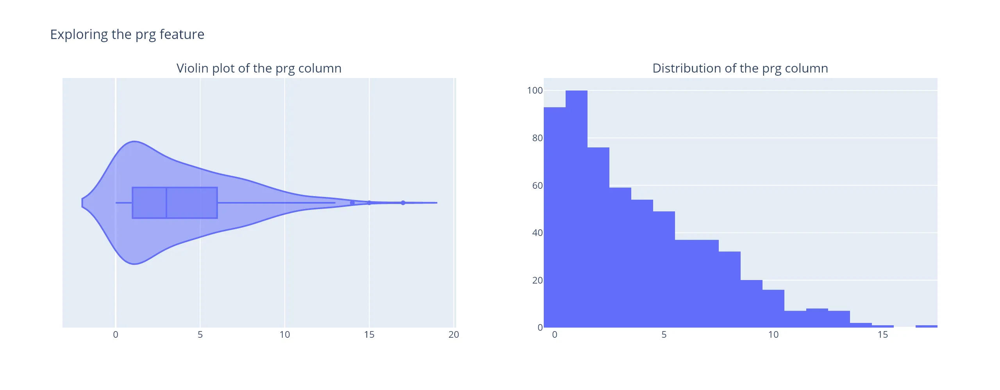

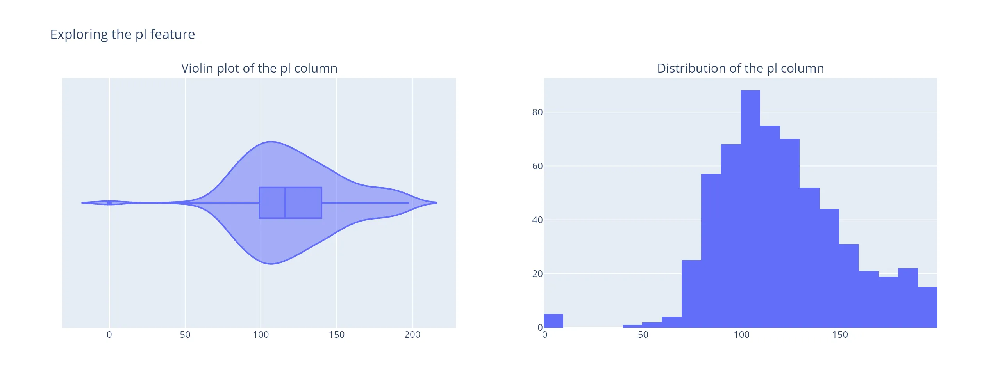

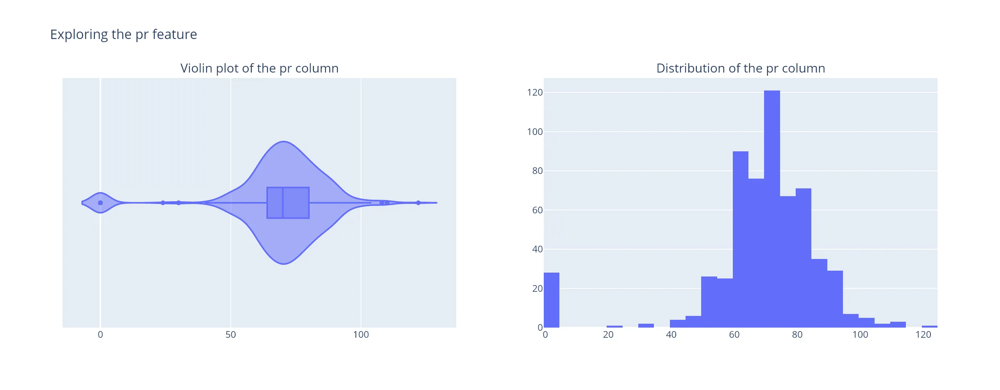

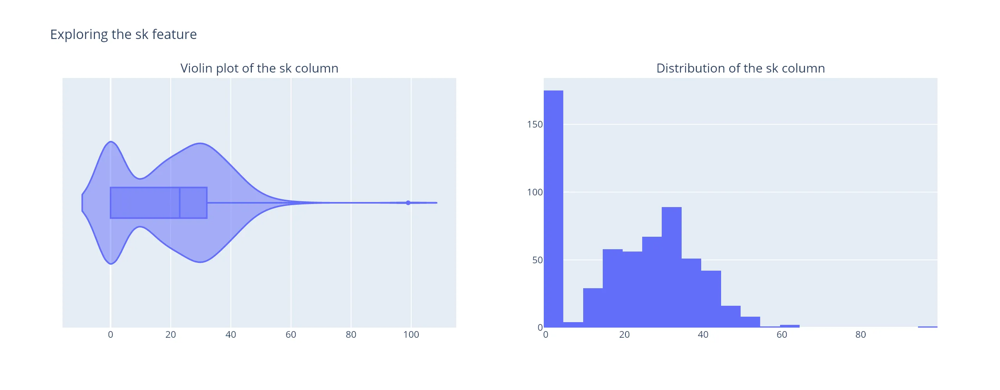

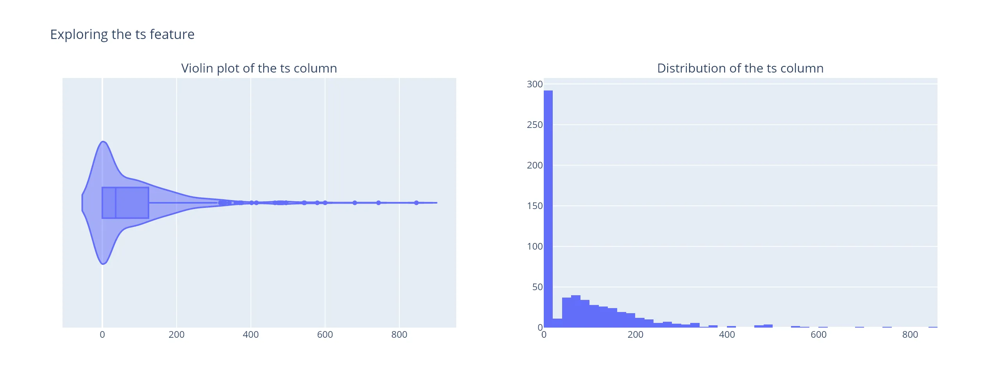

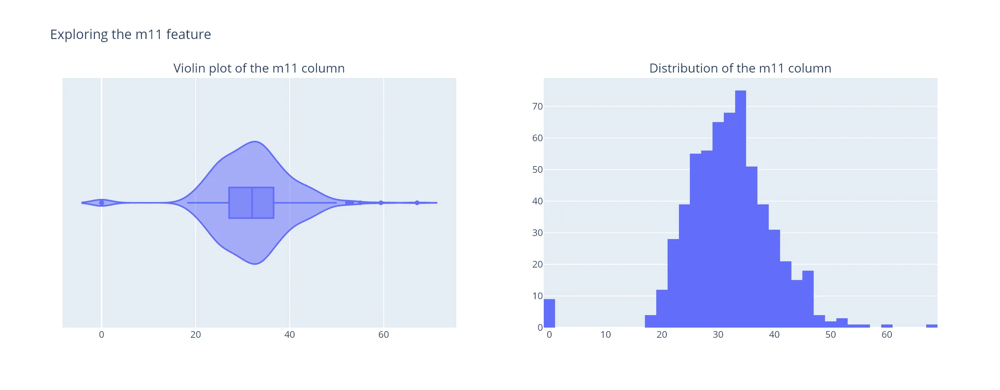

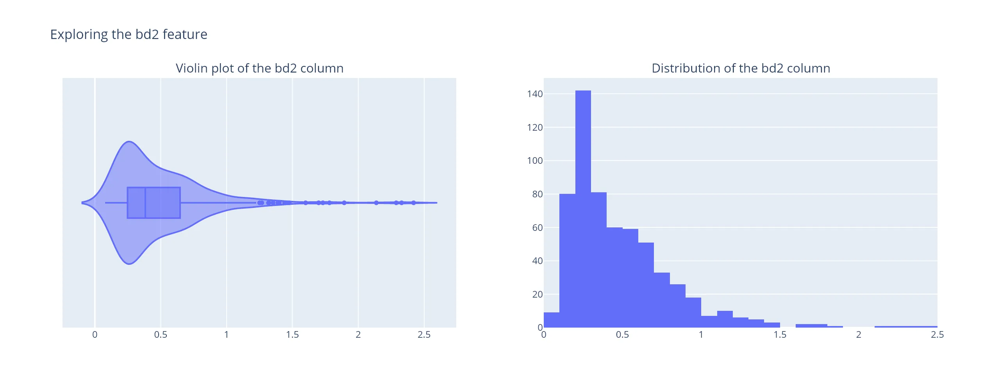

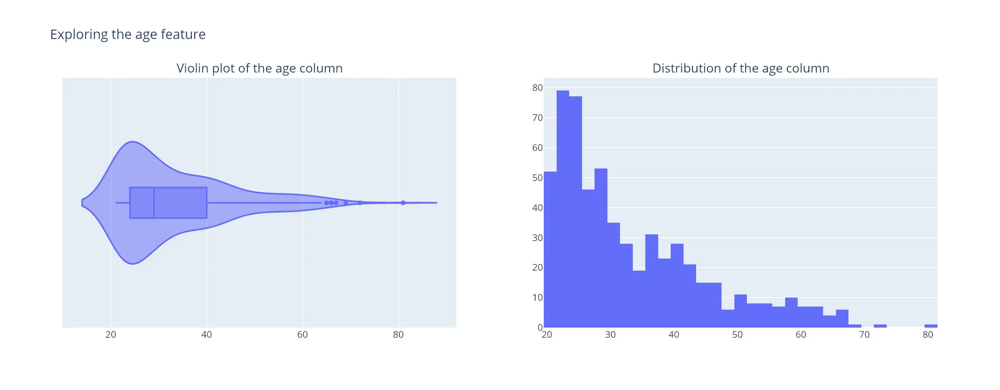

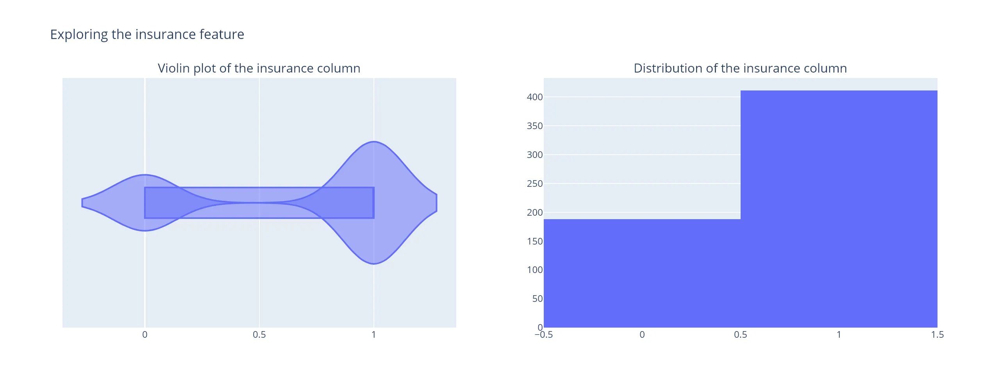

In [20]:
# Visualize their distributions
for column in df_train[numericals].columns:
    fig1 = px.violin(df_train, x=column, box=True)
    
    fig2 = px.histogram(df_train, x=column)
    
    # Create a subplot layout with 1 row and 2 columns
    fig = make_subplots(rows=1, cols=2, subplot_titles=(f"Violin plot of the {column} column",
                                                    f"Distribution of the {column} column"))
    
    # Add traces from fig1 to the subplot
    for trace in fig1.data:
        fig = fig.add_trace(trace, row=1, col=1)

    # Add traces from fig2 to the subplot
    for trace in fig2.data:
        fig = fig.add_trace(trace, row=1, col=2)            
        
    # Update layout
    fig = fig.update_layout(title_text=f"Exploring the {column} feature", 
                        showlegend=True,
                        legend_title_text=target
    )
    
    show_plot(fig)    

### Key Insights

- `PRG (Plasma Glucose):` Highly skewed to the right, with most values below 5.
- `PL (Blood Work Result-1):` Normally distributed, centered around 100.
- `PR (Blood Pressure):` Right-skewed, with most values around 70-80 mm Hg.
- `SK (Blood Work Result-2):` Right-skewed, with most values under 20.
- `TS (Blood Work Result-3):` Highly right-skewed, with most values below 200.
- `M11 (BMI):` Approximately normally distributed, centered around 30.
- `BD2 (Blood Work Result-4):` Highly right-skewed, with most values below 0.5.
- `Age:` left-skewed, with most patients aged 20-40.
- `Insurance:` Bimodal distribution, indicating two distinct groups (with and without insurance), with more patients holding insurance.

### 2.5.1.1.2 Bivariate

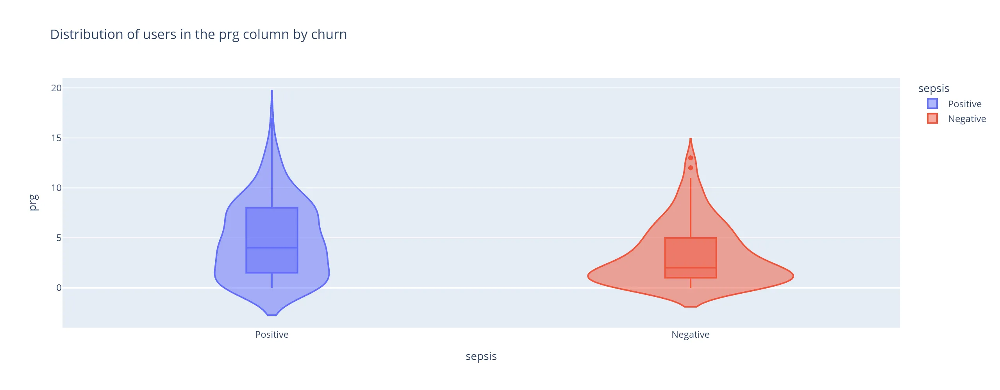

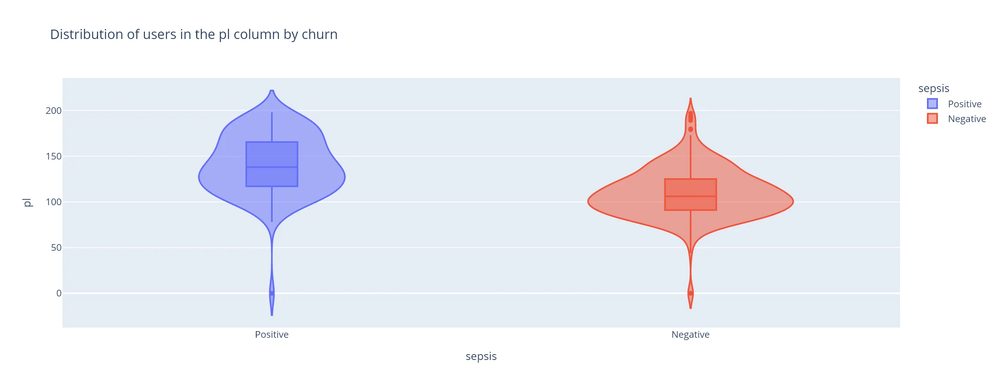

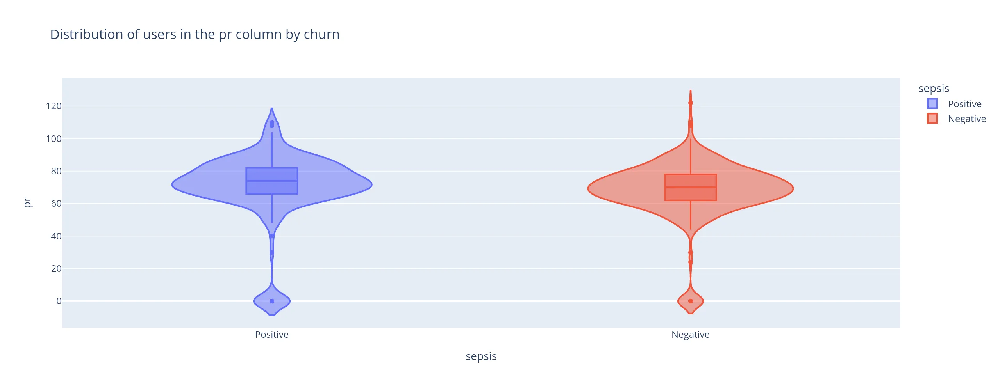

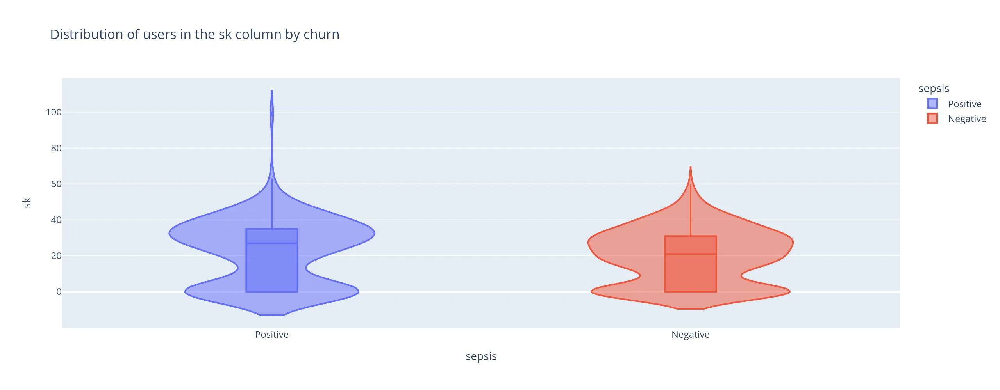

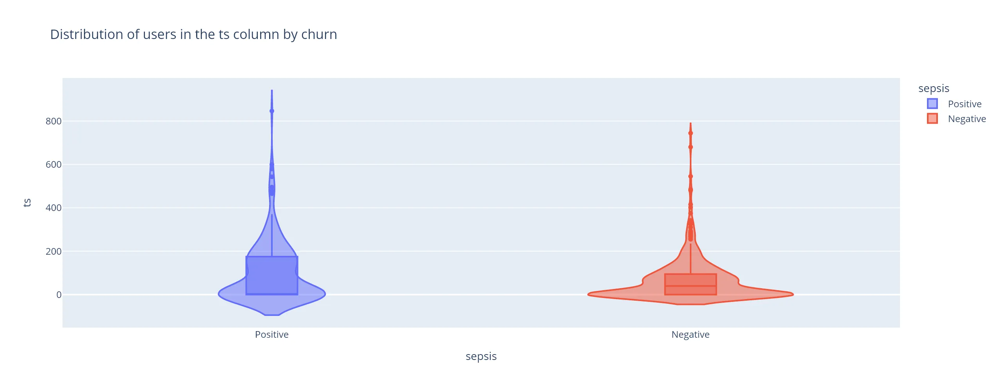

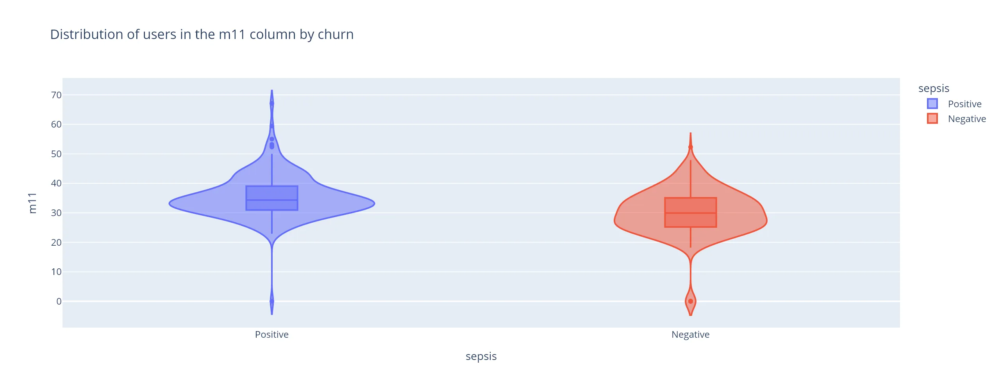

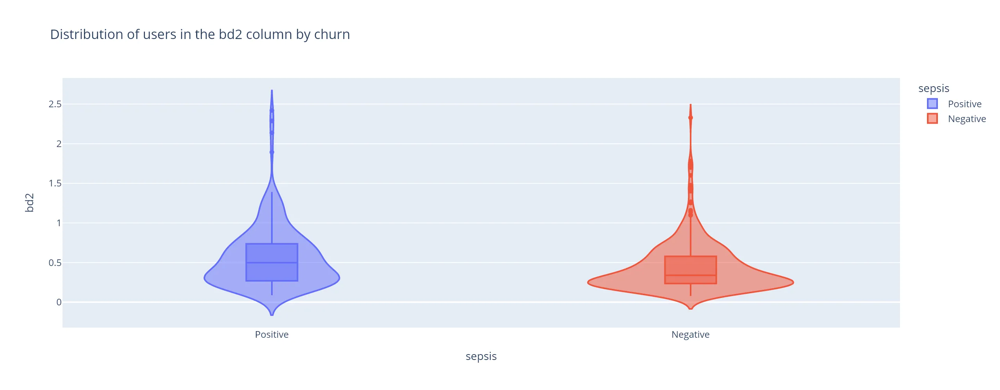

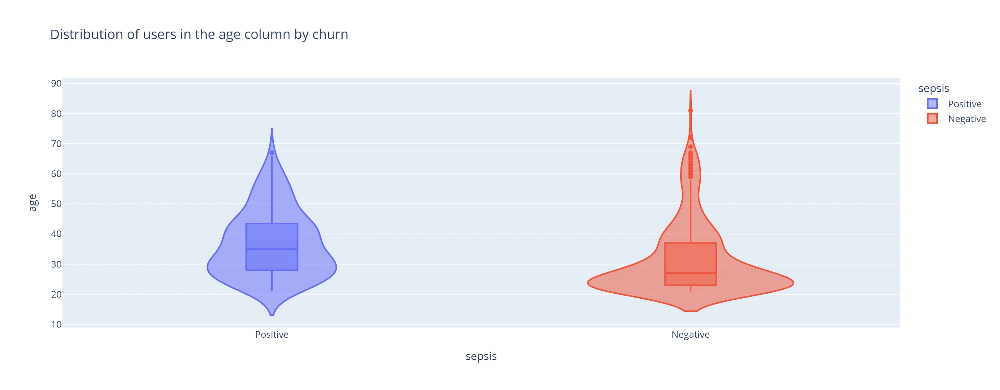

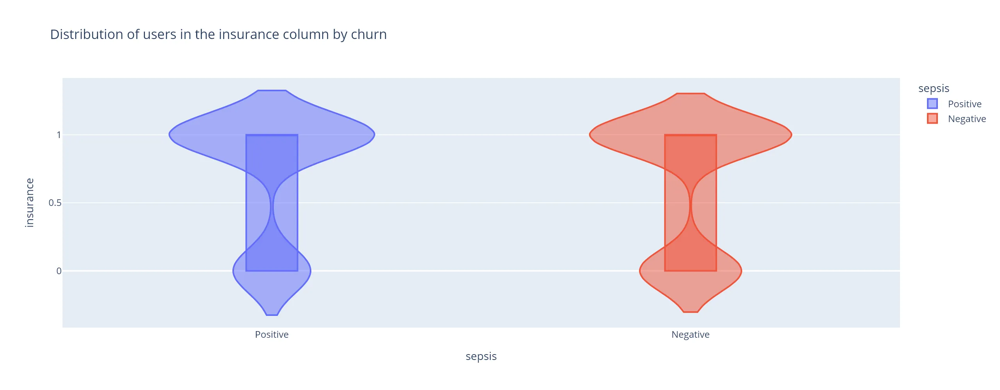

In [21]:
for column in numericals:
    # Visualizing the distribution of the numericals in the columns by churn
    fig = px.violin(
        df_train, 
        x=target,
        y=column, 
        color=target, 
        box=True,       
        title=f"Distribution of users in the {column} column by churn"
    )
    
    show_plot(fig)

### 2.5.1.1.3 Multivariate


In [ ]:
pca = PCA(n_components=3)

X = df_train[numericals+[target]].dropna()

components = pca.fit_transform(X.drop(columns=target))

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=X[target], 
    title=f'3D Principal Component Analysis of the Sepsis Dataset: Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    height=800
)

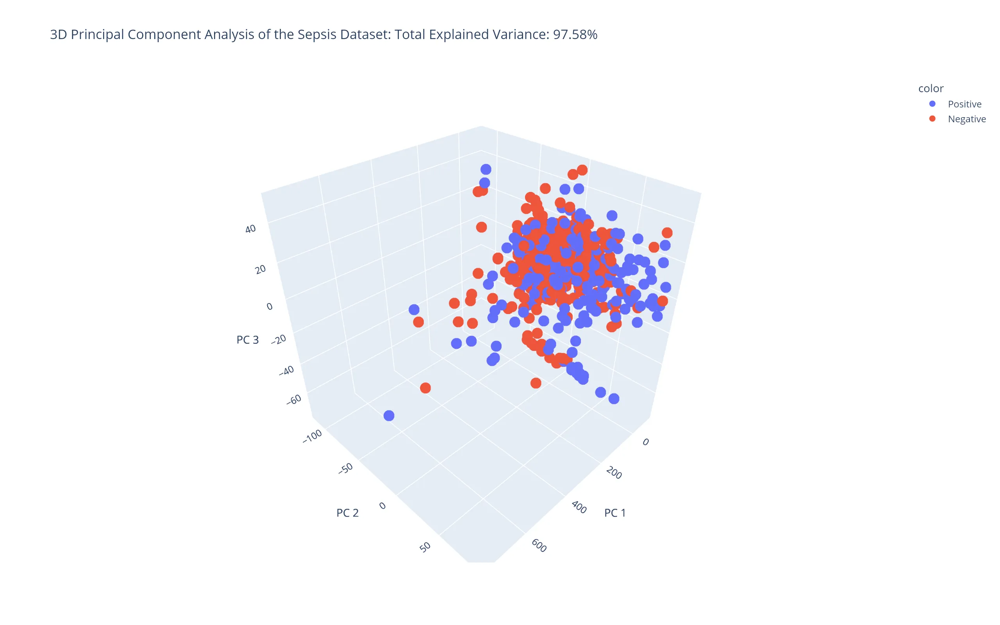

In [23]:
show_plot(fig)

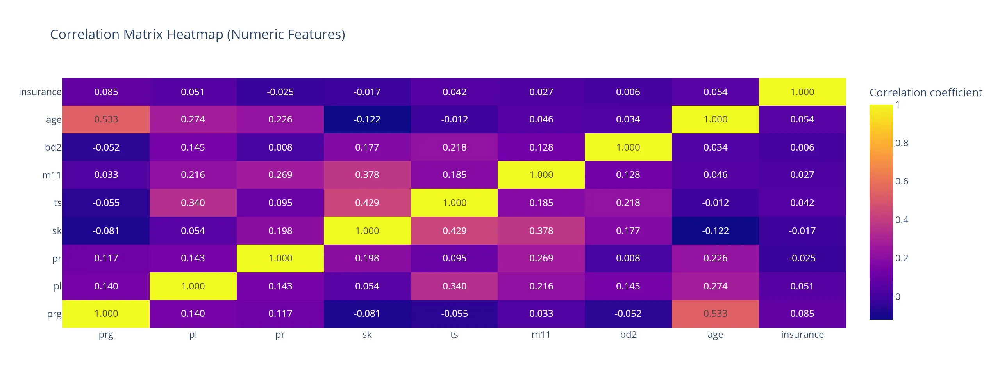

In [24]:
# Calculate correlation matrix
numeric_correlation_matrix = df_train[numericals].corr()

# Create heatmap trace
heatmap_trace = go.Heatmap(
    z=numeric_correlation_matrix.values,
    x=numeric_correlation_matrix.columns,
    y=numeric_correlation_matrix.index,
    colorbar=dict(title='Correlation coefficient'),
    texttemplate='%{z:.3f}',
)

# Create figure
fig = go.Figure(data=[heatmap_trace])

# Update layout
fig = fig.update_layout(
    title='Correlation Matrix Heatmap (Numeric Features)',
)

# Show plot
show_plot(fig)

### Key Insights
1. **Strongest Positive Correlations**:
   - **Age and PRG (0.53)**: Older patients tend to have higher plasma glucose levels.
   - **PL and TS (0.34)**: These two blood work results are moderately correlated.
   - **SK and TS (0.43)**: These two blood work results also show a moderate correlation.

2. **Weak to No Correlations**:
   - **Insurance**: Very weak correlations with all other variables.
   - **BD2**: Very weak correlations with other variables, indicating it is relatively independent.

3. **Other Notable Correlations**:
   - **PL and M11 (0.22)**: Some correlation between blood work result PL and BMI.
   - **PR and M11 (0.27)**: Blood pressure and BMI are somewhat correlated.

Most variables exhibit weak correlations, suggesting they are largely independent of each other. The notable exceptions are the moderate correlations among certain blood work results and between age and plasma glucose levels.

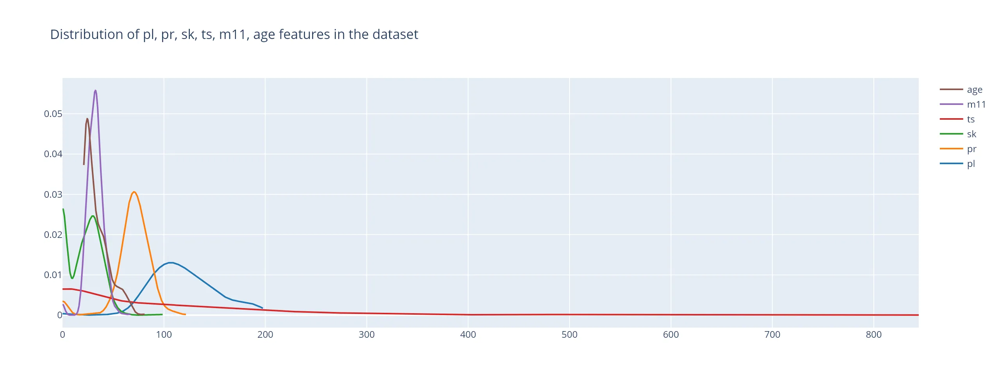

In [25]:
cols_of_interest = ['pl', 'pr', 'sk', 'ts', 'm11', 'age']
hist_data = [df_train[col] for col in cols_of_interest]

fig = ff.create_distplot(hist_data, cols_of_interest, show_hist=False,show_rug=False)

# Add title to the figure
fig.update_layout(title_text=f"Distribution of {', '.join(cols_of_interest)} features in the dataset")

show_plot(fig)

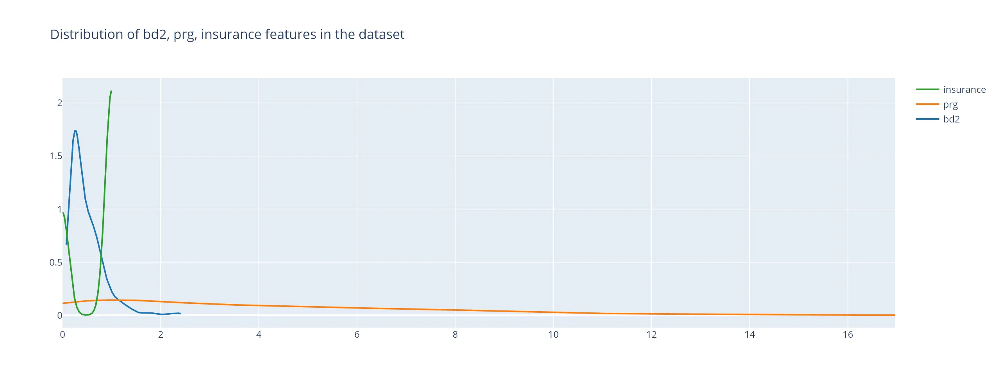

In [26]:

cols_of_interest = ['bd2', 'prg', 'insurance']
hist_data = [df_train[col] for col in cols_of_interest]

fig = ff.create_distplot(hist_data, cols_of_interest, show_hist=False,show_rug=False)

# Add title to the figure
fig.update_layout(title_text=f"Distribution of {', '.join(cols_of_interest)} features in the dataset")

show_plot(fig)

### Key Insight

These distributions suggest that the majority of feature values are clustered at lower ranges, with some features having a few higher values particularly the prg (plasma glucose) values.

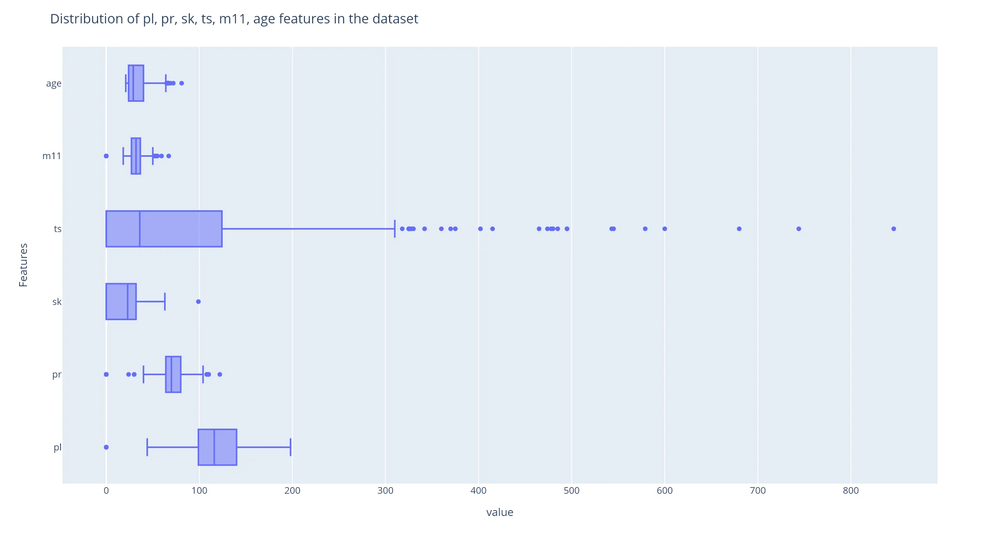

In [27]:

# Create the boxplot
cols_of_interest = ['pl', 'pr', 'sk', 'ts', 'm11', 'age']

fig = px.box(
    df_train[cols_of_interest], 
    orientation='h',
    labels={'variable': 'Features'}, 
    height=700)

# Add title to the figure
fig.update_layout(title=f"Distribution of {', '.join(cols_of_interest)} features in the dataset")

# Show the plot
show_plot(fig)

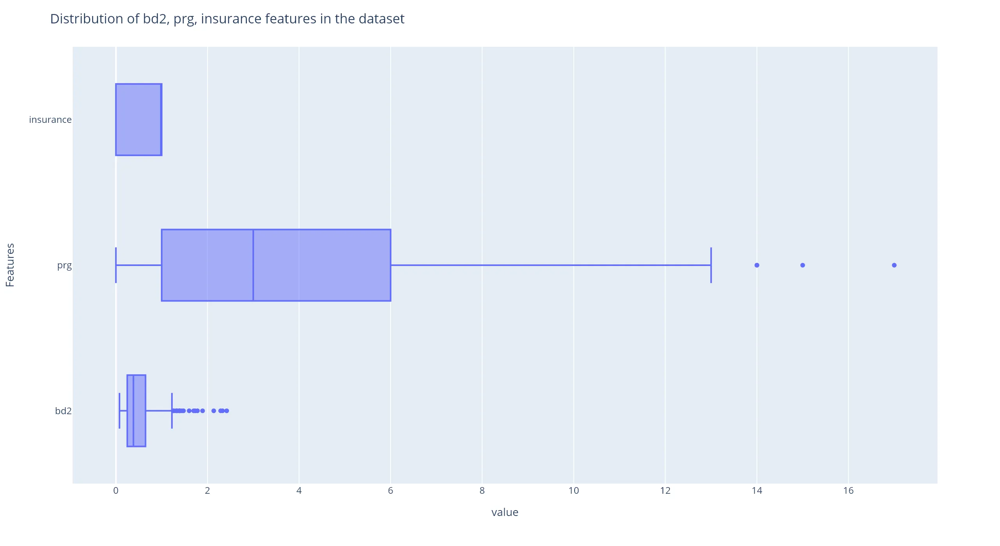

In [28]:

# Create the boxplot
cols_of_interest = ['bd2', 'prg', 'insurance']

fig = px.box(
    df_train[cols_of_interest], 
    orientation='h', 
    labels={'variable': 'Features'},
    height=700
)

# Add title to the figure
fig.update_layout(title=f"Distribution of {', '.join(cols_of_interest)} features in the dataset")

# Show the plot
show_plot(fig)

### Key Insights

- TS(Blood Work Result-3) stands out with a wide range and numerous outliers, indicating significant variability.
- PL(Blood Work Result-1) and Age also show moderate dispersion and outliers.
- Other features, such as PRG and BD2, have smaller ranges and fewer outliers.

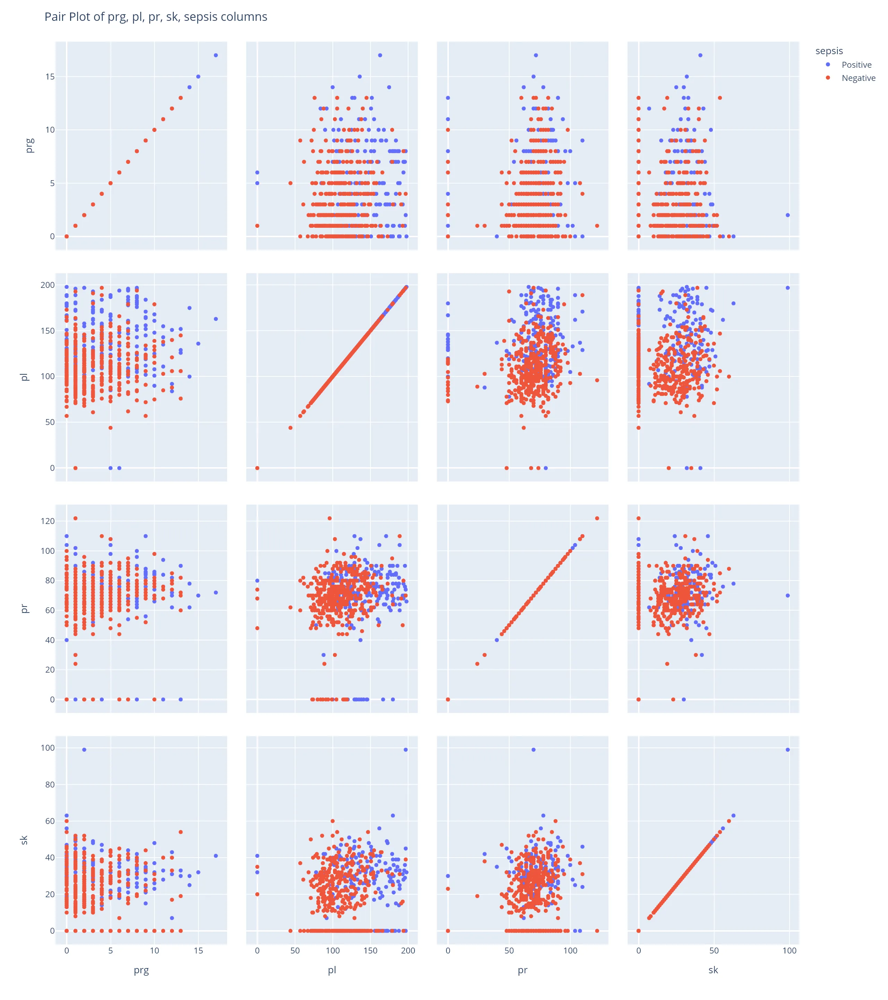

In [29]:
# Select the columns to use
cols_to_interest = ['prg', 'pl', 'pr', 'sk', 'sepsis']

# Create the pair plot
fig = px.scatter_matrix(df_train[cols_to_interest], dimensions=[col for col in cols_to_interest if col!='sepsis'], color='sepsis')

# Update the layout for better visualization
fig.update_layout(
    title=f"Pair Plot of {', '.join(cols_to_interest)} columns",
    width=1440,
    height=1440
)

# Show the plot
show_plot(fig)

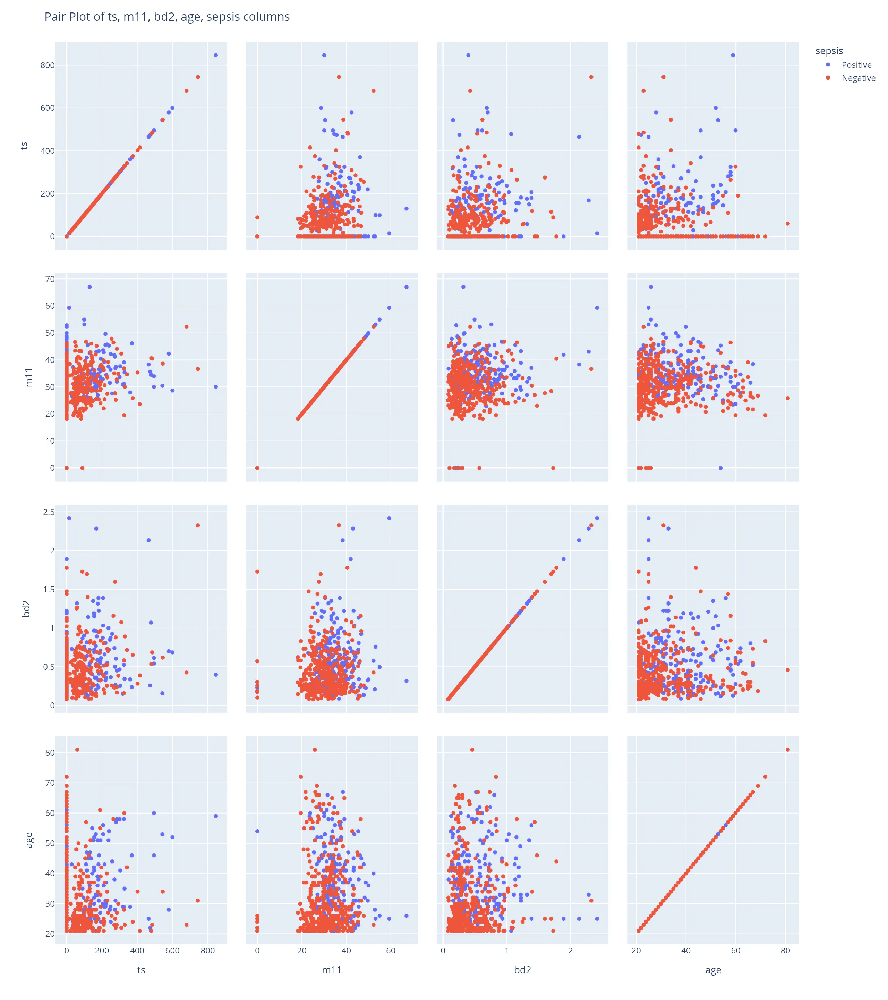

In [30]:
# Select the columns to use
cols_to_interest = ['ts', 'm11', 'bd2', 'age', 'sepsis']

# Create the pair plot
fig = px.scatter_matrix(df_train[cols_to_interest], dimensions=[col for col in cols_to_interest if col!='sepsis'], color='sepsis')

# Update the layout for better visualization
fig.update_layout(
    title=f"Pair Plot of {', '.join(cols_to_interest)} columns",
    width=1440,
    height=1440
)

# Show the plot
show_plot(fig)

### Key Insights
This pair plot visualizes the relationships between PRG (Plasma Glucose), Age, and M11 (BMI) for patients categorized by sepsis status:

1. **PRG vs. Age**: Positive sepsis cases (blue) tend to have higher plasma glucose levels than negative cases (orange), especially noticeable in younger patients.
2. **PRG vs. M11**: There is no clear separation between sepsis-positive and sepsis-negative cases based on BMI and plasma glucose levels.
3. **Age vs. M11**: Younger patients with lower BMI appear more likely to develop sepsis, while older patients show a mix of outcomes.
4. **Distributions**:
    - **PRG**: Higher plasma glucose levels are more common in sepsis-positive cases.
    - **Age**: Sepsis-positive cases are spread across a wider age range compared to negative cases.
    - **M11**: The BMI distribution is similar for both sepsis-positive and sepsis-negative cases, with a slight shift towards higher BMI in sepsis-negative cases.

Overall, higher plasma glucose levels and lower BMIs in younger patients might be associated with sepsis development.

### 2.6 Hypothesis Testing

In [31]:
alpha = 0.01

**Hypothesis 1:** Age and Sepsis

`Null Hypothesis(Ho):` Older patients (age 60 and above) are less likely to develop sepsis compared to younger patients (below 60 years)

`Alternate Hypothesis(Ha):` Older patients (age 60 and above) are more likely to develop sepsis compared to younger patients (below 60 years)

In [32]:
df_age_sepsis = df_train.copy()
df_age_sepsis['age_group'] = df_train['age'].apply(lambda x: '60 and above' if x >= 60 else 'below 60')
 
contingency_table = pd.crosstab(df_age_sepsis['age_group'], df_train['sepsis']) 

print(contingency_table)
  
# Perform the chi-square test
chi2, p, dof, expected = chi2_contingency(contingency_table) 
print(f"Chi-square statistic: {chi2}")
print(f"p-value: {p}")

sepsis        Negative  Positive
age_group                       
60 and above        20         7
below 60           371       201
Chi-square statistic: 0.601967563891041
p-value: 0.43782829453541183


In [33]:
if p < alpha:     
       print("We reject the Null Hypothesis: There is a significant association between age group and sepsis outcome.")
else:     
     print("There is no significant association between age group and sepsis outcome.")

There is no significant association between age group and sepsis outcome.


### Key Insights: Age and Sepsis

#### Chi-Square Test Results

| Sepsis       | Negative | Positive |
|--------------|----------|----------|
| **Age Group**           |          |          |
| 60 and above | 20       | 7        |
| below 60     | 371      | 201      |

- **Chi-square statistic:** 0.601967563891041
- **P-value:** 0.43782829453541183

#### Analysis

The Chi-square test was conducted to evaluate whether there is a significant association between age groups (60 and above vs. below 60) and the occurrence of sepsis.

**Key Findings:**

1. **Chi-square statistic:** The chi-square statistic of 0.60 indicates the observed and expected frequencies are quite similar. A small chi-square statistic suggests there is little difference between the observed data and the expected data under the null hypothesis.

2. **P-value:** The p-value of 0.4378 is greater than the typical significance level of 0.05. This indicates insufficient evidence to reject the null hypothesis.

#### Interpretation

- **Significance:** Given the p-value is larger than 0.05, we fail to reject the null hypothesis. This means there is no statistically significant association between age group and the likelihood of developing sepsis.
  
- **Clinical Implication:** The results suggest that age, specifically being 60 years or older, does not significantly increase or decrease the likelihood of developing sepsis compared to younger patients (below 60 years).


The Chi-square test results indicate that there is no significant relationship between age groups and the occurrence of sepsis. This finding implies that both older patients (60 and above) and younger patients (below 60) have similar probabilities of developing sepsis. Consequently, age alone may not be a reliable predictor of sepsis risk, suggesting the need for a multifactorial approach in assessing sepsis risk.

**Hypothesis 2:** Plasma levels and Sepsis

`Null Hypothesis(Ho):` There is no significant relationship between plasma levels and the occurrence of sepsis.

`Alternate Hypothesis(Ha):` A significant relationship exists between plasma levels and the occurrence of sepsis.

In [34]:
# Plasma levels for sepsis positive and negative cases
positive_sepsis_pl = df_train[df_train['sepsis'] == 'Positive']['pl']
negative_sepsis_pl = df_train[df_train['sepsis'] == 'Negative']['pl']

# Perform Mann-Whitney U Test
u_statistic, p_value = mannwhitneyu(positive_sepsis_pl, negative_sepsis_pl, alternative='two-sided')

# Print the results
print("Mann-Whitney U Test Results:")
print(f"U-statistic: {u_statistic}")
print(f"P-value: {p_value}")

Mann-Whitney U Test Results:
U-statistic: 63515.5
P-value: 9.039444101550678e-30


In [35]:
# Interpret the result
if p_value < alpha:
    print("Reject the null hypothesis (Ho): A significant relationship exists between plasma levels and the occurrence of sepsis.")
else:
    print("Fail to reject the null hypothesis (Ho): There is no significant relationship between plasma levels and the occurrence of sepsis.")

Reject the null hypothesis (Ho): A significant relationship exists between plasma levels and the occurrence of sepsis.


### Key Insights: Plasma Levels and Sepsis

#### Mann-Whitney U Test Results

- **U-statistic:** 63,515.5
- **P-value:** 9.04e-30

#### Analysis

The Mann-Whitney U test was conducted to determine if there is a significant difference between the plasma levels of patients who developed sepsis and those who did not. This non-parametric test is appropriate given the non-normal distribution of plasma levels.

**Key Findings:**

1. **U-statistic:** The U-statistic of 63,515.5 indicates the sum of ranks for the two groups. A large U-statistic suggests a difference in the distributions of plasma levels between the two groups.

2. **P-value:** The p-value of 9.04e-30 is extremely small, far below the typical significance level of 0.05. This indicates a very strong statistical evidence against the null hypothesis.

#### Interpretation

- **Significance:** Given the p-value is much smaller than 0.05, we reject the null hypothesis. This means there is a statistically significant difference between the plasma levels of patients who developed sepsis and those who did not.
  
- **Clinical Implication:** The results suggest that plasma levels are significantly associated with the occurrence of sepsis. This finding supports the hypothesis that plasma levels can be a critical indicator in predicting sepsis, potentially guiding early intervention and treatment strategies.

The Mann-Whitney U test provides compelling evidence that plasma levels differ significantly between patients who develop sepsis and those who do not. This underscores the importance of plasma levels as a biomarker for sepsis prediction, highlighting its potential role in clinical decision-making and patient management.

### 2.7 Business Questions 💼

#### 2.7.1 Is there a relationship between body mass index (M11) and the development of sepsis?

In [36]:
# Summary statistics
print(df_train.groupby('sepsis')['m11'].describe())

          count  mean  std  min   25%   50%   75%   max
sepsis                                                 
Negative 391.00 30.08 7.81 0.00 25.20 29.90 35.05 52.30
Positive 208.00 35.39 7.20 0.00 30.98 34.30 39.02 67.10


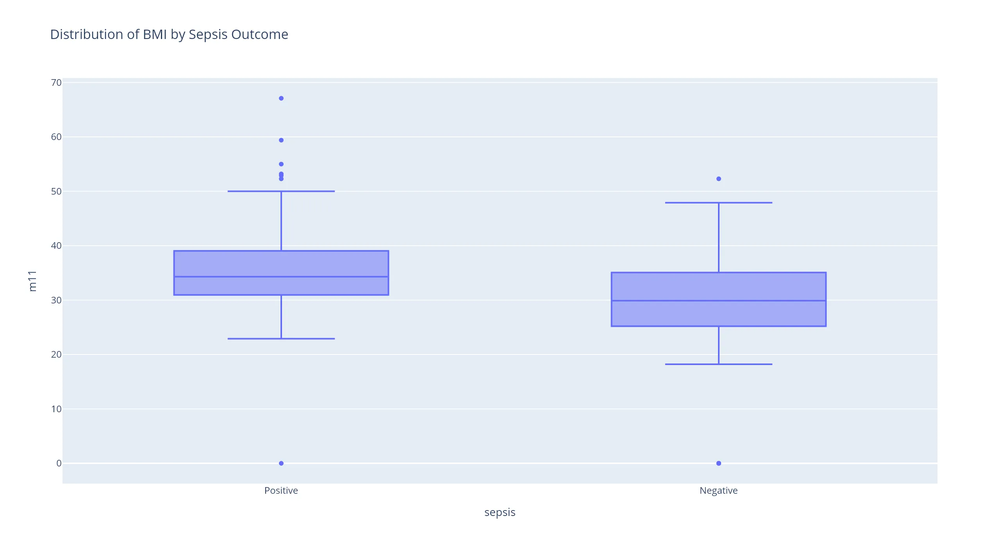

In [37]:
# Create a box plot using Plotly Express
fig = px.box(
    df_train, x='sepsis', y='m11', 
    title='Distribution of BMI by Sepsis Outcome',
    labels={'Sepsis': 'Sepsis Outcome', 'M11': 'Body Mass Index (BMI)'},
    height=700
)

# Show the plot
show_plot(fig)

In [38]:
# Separate BMI values by sepsis outcome
sepsis_positive_bmi = df_train[df_train['sepsis'] == 'Positive']['m11']
sepsis_negative_bmi = df_train[df_train['sepsis'] == 'Negative']['m11']

# Perform Mann-Whitney U Test
u_statistic, p_value = mannwhitneyu(sepsis_positive_bmi, sepsis_negative_bmi, alternative='two-sided')

# Print the results
print("Mann-Whitney U Test Results:")
print(f"U-statistic: {u_statistic}")
print(f"P-value: {p_value}")

Mann-Whitney U Test Results:
U-statistic: 56864.0
P-value: 9.46574491775568e-16


In [39]:
# Interpret the result
if p_value < alpha:
    print("Reject the null hypothesis (Ho): A significant relationship exists between body mass index (M11) and the development of sepsis.")
else:
    print("Fail to reject the null hypothesis (Ho): There is no significant relationship between body mass index (M11) and the development of sepsis.")

Reject the null hypothesis (Ho): A significant relationship exists between body mass index (M11) and the development of sepsis.


### Key Insights: Relationship Between Body Mass Index (BMI) and Sepsis


**1. Summary Statistics:**

- **Mean BMI:** The median BMI for patients with sepsis is higher (34.30) compared to those without sepsis (29.90). This indicates that, on average, patients who developed sepsis have a higher BMI.
- **Standard Deviation:** The standard deviation for BMI is slightly lower in the sepsis-positive group (7.20) compared to the sepsis-negative group (7.81), suggesting less variability in BMI among patients with sepsis.
- **Range and Quartiles:** The BMI range and quartiles for both groups show that while sepsis-positive patients generally have higher BMIs, there is considerable overlap between the two groups. For instance, the maximum BMI in the sepsis-positive group (67.10) exceeds the 75th percentile BMI of the sepsis-negative group (35.05).

**2. Mann-Whitney U Test Results:**

- **U-statistic:** The U-statistic of 56,864.0 reflects the sum of ranks comparing the two groups. A high U-statistic indicates a substantial difference in BMI distributions between the sepsis-positive and sepsis-negative groups.
- **P-value:** The extremely low p-value (9.47e-16) indicates a very strong statistical significance, far below the conventional threshold of 0.05.

### Interpretation

- **Significance:** The p-value being significantly less than 0.05 leads us to reject the null hypothesis. There is strong evidence to suggest that there is a significant difference in BMI between patients who develop sepsis and those who do not.
  
- **Clinical Implication:** The higher average BMI in the sepsis-positive group suggests that body mass index may be an important factor in the development of sepsis. This finding implies that elevated BMI could be associated with a higher risk of sepsis, warranting further investigation into BMI as a potential risk factor for sepsis.

The statistical analysis demonstrates a significant relationship between BMI and the development of sepsis. Patients with sepsis tend to have a higher average BMI compared to those without sepsis, and the Mann-Whitney U test confirms this difference with strong statistical significance. This relationship underscores the need for clinicians to consider BMI as a potential risk factor when assessing patients for sepsis and highlights the importance of further research to understand the underlying mechanisms linking BMI to sepsis.

### 2.7.2. Are there noticeable differences in blood pressure (PR) readings between sepsis-positive and sepsis-negative patients?


          count  mean   std  min   25%   50%   75%    max
sepsis                                                   
Negative 391.00 67.87 17.92 0.00 62.00 70.00 78.00 122.00
Positive 208.00 70.35 21.71 0.00 66.00 74.00 82.00 110.00


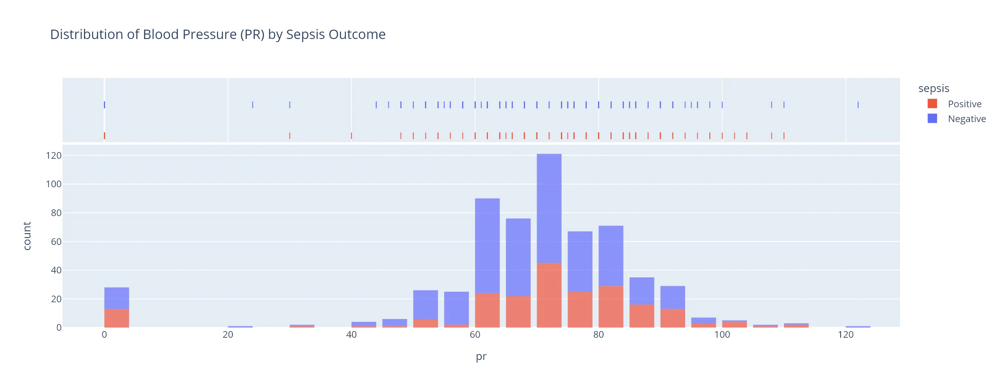

In [33]:
# Calculate summary statistics
summary_stats = df_train.groupby('sepsis')['pr'].describe()
print(summary_stats)

# Show plot
pr_sepsis_df = df_train[['pr', 'sepsis']]
   
color_discrete_sequence = [px.colors.qualitative.Plotly[1], px.colors.qualitative.Plotly[0]]

fig = px.histogram(
    pr_sepsis_df, 
    x='pr', 
    color='sepsis', 
    marginal="rug", 
    title='Distribution of Blood Pressure (PR) by Sepsis Outcome',
    nbins=50, 
    opacity=0.7,
    color_discrete_sequence=color_discrete_sequence
)

fig = fig.update_layout(
    bargap=0.2,
)

show_plot(fig)


In [34]:
# Extract PR values for each group
sepsis_positive = df_train[df_train['sepsis'] == 'Positive']['pr']
sepsis_negative = df_train[df_train['sepsis'] == 'Negative']['pr']

# Perform Mann-Whitney U test
u_stat, p_value = mannwhitneyu(sepsis_positive, sepsis_negative)
print(f"Mann-Whitney U test p-value: {p_value}")

# Correct the logic in the if statement
if p_value > 0.01:     
    print("There are no noticeable differences in Blood Pressure(PR) readings between sepsis-positive and sepsis-negative patients")
else:     
    print("There are noticeable differences in Blood Pressure(PR) readings between sepsis-positive and sepsis-negative patients")

Mann-Whitney U test p-value: 0.0005014049708706393
There are noticeable differences in Blood Pressure(PR) readings between sepsis-positive and sepsis-negative patients


### Key Insights

#### Blood Pressure (PR) Distribution by Sepsis Outcome

- **Shape of Distribution**: The distributions of blood pressure readings for both sepsis-negative and sepsis-positive groups exhibit a roughly bell-shaped curve.
  
- **Peak Values**: The sepsis-negative group peaks around a PR of 65, while the sepsis-positive group peaks higher, around a PR of 75.

- **Lower Blood Pressure Values**: There is a higher concentration of sepsis-negative cases at lower blood pressure values (around a PR of 60), compared to the sepsis-positive cases.

- **Higher Blood Pressure Values**: Conversely, sepsis-positive cases are more frequent at higher blood pressure values, indicating a potential correlation between higher blood pressure and positive sepsis outcomes.

- **Statistical Significance**: The Mann-Whitney U test reveals a statistically significant difference in blood pressure readings between sepsis-positive and sepsis-negative patients, with a p-value of 0.0005.

These observations indicate notable differences in blood pressure distributions between sepsis-positive and sepsis-negative patients, with sepsis-positive patients generally exhibiting higher blood pressure readings.


### 2.7.3. What is the correlation between plasma levels and the prevalence of sepsis?


          count  mean  std  min  25%  50%  75%   max
sepsis                                              
Negative 391.00  3.32 3.02 0.00 1.00 2.00 5.00 13.00
Positive 208.00  4.78 3.76 0.00 1.75 4.00 8.00 17.00


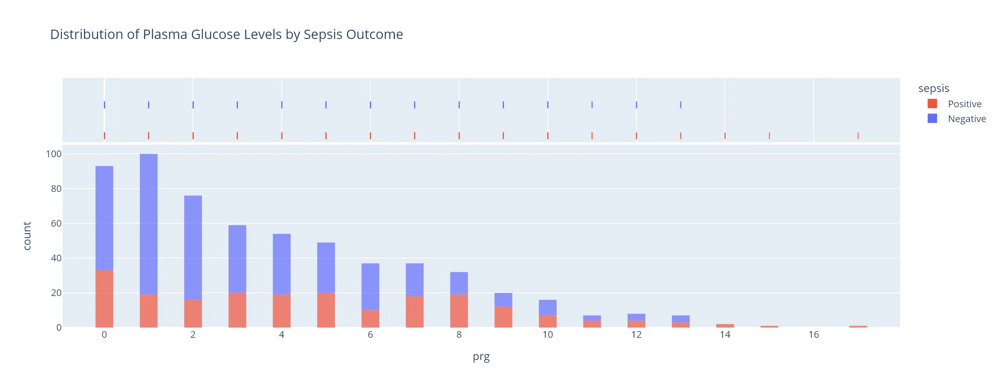

In [47]:
# Calculate summary statistics
summary_stats = df_train.groupby('sepsis')['prg'].describe()
print(summary_stats)

# Show Plot
prg_sepsis_df = df_train[['prg', 'sepsis']]
   
color_discrete_sequence = [px.colors.qualitative.Plotly[1], px.colors.qualitative.Plotly[0]]

fig = px.histogram(
    prg_sepsis_df, 
    x='prg', 
    color='sepsis', 
    marginal="rug",              
    title='Distribution of Plasma Glucose Levels by Sepsis Outcome',
    nbins=50, 
    opacity=0.7,
    color_discrete_sequence=color_discrete_sequence
)

fig = fig.update_layout(bargap=0.2)

show_plot(fig)

In [48]:
# Extract prg values for each group
sepsis_positive_prg = df_train[df_train['sepsis'] == 'Positive']['prg']
sepsis_negative_prg = df_train[df_train['sepsis'] == 'Negative']['prg']

# Perform Mann-Whitney U test
u_stat, p_value = mannwhitneyu(sepsis_positive_prg, sepsis_negative_prg)
print(f"Mann-Whitney U test p-value: {p_value}")

# Correct the logic in the if statement
if p_value > 0.01:     
    print("There are no noticeable differences in Plasma Glucose (prg) readings between sepsis-positive and sepsis-negative patients")
else:     
    print("There are noticeable differences in Plasma Glucose (prg) readings between sepsis-positive and sepsis-negative patients")

Mann-Whitney U test p-value: 7.517335229649623e-06
There are noticeable differences in Plasma Glucose (prg) readings between sepsis-positive and sepsis-negative patients


### Key Insights

#### Statistical Insights

- **Mean PRG**: Sepsis-positive patients exhibit a higher mean plasma glucose level of 4.78 compared to sepsis-negative patients, who have a mean of 3.32.
  
- **Median PRG**: The median plasma glucose level for sepsis-positive patients is 4.00, notably higher than the median of 2.00 for sepsis-negative patients.
  
- **Interquartile Range (IQR)**: The IQR for sepsis-positive patients ranges from 1.75 to 8.00, compared to a range of 1.00 to 5.00 for sepsis-negative patients, indicating a wider spread of plasma glucose levels among the sepsis-positive group.
  
- **Standard Deviation (Std)**: The standard deviation for sepsis-positive patients is 3.76, higher than the 3.02 for sepsis-negative patients. This suggests greater variability in plasma glucose levels among sepsis-positive patients.

#### Visualization Insights

- **Distribution Shape**: The distribution of plasma glucose levels for sepsis-negative patients is heavily skewed towards lower values, with a significant peak at 0-2.5 PRG.
  
- **Distribution Spread**: Conversely, the sepsis-positive group displays a more even distribution across different glucose levels, with a noticeable peak around 10 PRG. This pattern indicates that lower plasma glucose levels are more commonly associated with sepsis-negative outcomes, whereas higher glucose levels are more indicative of sepsis-positive outcomes.

#### Statistical Significance

- **Mann-Whitney U Test**: The Mann-Whitney U test yields a p-value of 7.52e-06, confirming that the differences in plasma glucose (PRG) readings between sepsis-positive and sepsis-negative patients are statistically significant. 


These observations highlight the distinct differences in plasma glucose levels between sepsis-positive and sepsis-negative patients, with higher glucose levels potentially serving as an indicator for positive sepsis outcomes.

 
4. How do plasma glucose levels (PRG) differ between patients who develop sepsis and those who do not?

5. How does Body Mass Index (BMI) affect the incidence of sepsis?

6. What is the average/median age of patients who develop sepsis and those without sepsis?

7. Which blood pressure levels are most strongly associated with the development of sepsis?

8. Are insured patients more or less susceptible to sepsis?

## 3.0 Data Preparation 🛠️

#### 3.1 Check for balanced dataset


In [40]:
class_counts = df_train[target].value_counts().reset_index()
class_counts.columns = ['sepsis_class', 'count']
class_counts

,sepsis_class,count
0,Negative,391
1,Positive,208


In [41]:
class_ratio =  class_counts.copy()
class_ratio['ratio'] = class_ratio['count'].apply(lambda x: x*100/class_counts['count'].sum())
class_ratio.drop(columns='count', inplace=True)
class_ratio

,sepsis_class,ratio
0,Negative,65.28
1,Positive,34.72


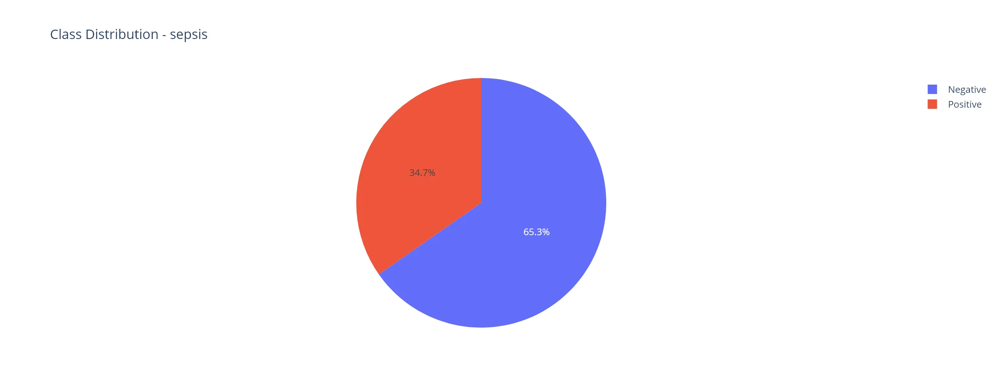

In [42]:
# Visualizing the class distribution of the target variable
fig = px.pie(class_ratio, values='ratio', names='sepsis_class', title=f'Class Distribution - {target}')
show_plot(fig)

### 3.2 Split Data into X and y then into train and eval for training and evaluation


In [43]:
df_train.isna().sum()

id           0
prg          0
pl           0
pr           0
sk           0
ts           0
m11          0
bd2          0
age          0
insurance    0
sepsis       0
dtype: int64

In [44]:
# Split the data into X and y
X = df_train.drop(columns=['id', target])
y = df_train[[target]]

In [45]:
features = X.columns.to_list()

In [46]:
categorical_features = ['insurance']

In [47]:
numerical_features = [feature for feature in features if feature not in categorical_features]
numerical_features

['prg', 'pl', 'pr', 'sk', 'ts', 'm11', 'bd2', 'age']

In [48]:
# Split the X and y into train and eval
X_train, X_eval, y_train, y_eval =  train_test_split(X, y, train_size=0.8, random_state=2024, stratify=y)
(X_train.shape, y_train.shape), (X_eval.shape, y_eval.shape), (df_test.shape)

(((479, 9), (479, 1)), ((120, 9), (120, 1)), (169, 10))

In [49]:
# Ensure the dimensions match
assert X_train.shape[1] == X_eval.shape[1], "Number of features doesn't match"

In [50]:
data_split_size = pd.DataFrame({
    'data': ['train', 'evaluation'],
    'size': [y_train.shape[0], y_eval.shape[0]]
})
data_split_size

,data,size
0,train,479
1,evaluation,120


In [51]:
encoder = LabelEncoder()

y_train_encoded = encoder.fit_transform(y_train.values.ravel())
y_eval_encoded = encoder.transform(y_eval.values.ravel())

#### 3.3 Creating preprocessing pipeline- feature creation, imputation, encoding, scaling, and transformation


#### 3.3.1 Feature Engineering

- Use utils.pipeline_helper to store pipeline functions to allow for consistent function attribute when joblib is used to load same functions in another namespace or project.

In [52]:
categorical_features

['insurance']

In [53]:
new_features

['age_group']

In [54]:
as_category

<function utils.pipeline_helper.as_category(data: Union[pandas.core.frame.DataFrame, pandas.core.series.Series]) -> Union[pandas.core.frame.DataFrame, pandas.core.series.Series]>

In [55]:
feature_creation

<function utils.pipeline_helper.feature_creation(df: pandas.core.frame.DataFrame) -> pandas.core.frame.DataFrame>

In [56]:
numerical_pipeline = Pipeline(
    steps = [
            ('log_transformations', FunctionTransformer(np.log1p)),
            ('imputer', SimpleImputer(strategy='median')), # Handle missing values
            ('scaler', RobustScaler()), # Scale numerics            
          ]
)

numerical_pipeline

Pipeline(steps=[('log_transformations',
                 FunctionTransformer(func=<ufunc 'log1p'>)),
                ('imputer', SimpleImputer(strategy='median')),
                ('scaler', RobustScaler())])

In [57]:
categorical_pipeline = Pipeline(
    steps = [
        ('as_categorical', FunctionTransformer(func=as_category, validate=False)),
        ('imputer', SimpleImputer(strategy='most_frequent')),   
        ('encoder', OneHotEncoder(drop='first', sparse_output=False, handle_unknown='infrequent_if_exist'))           
    ]
)

categorical_pipeline

Pipeline(steps=[('as_categorical',
                 FunctionTransformer(func=<function as_category at 0x0000013CE41B7600>)),
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoder',
                 OneHotEncoder(drop='first',
                               handle_unknown='infrequent_if_exist',
                               sparse_output=False))])

In [58]:
feature_creation_pipeline = Pipeline(
    steps = [
        ('feature_creation', FunctionTransformer(func=feature_creation, validate=False)), # Handle feature creation of categorical features
        ('imputer', SimpleImputer(strategy='most_frequent')),   
        ('encoder', OneHotEncoder(drop='first', sparse_output=False, handle_unknown='ignore'))           
    ]
)

feature_creation_pipeline

Pipeline(steps=[('feature_creation',
                 FunctionTransformer(func=<function feature_creation at 0x0000013CE41B7C40>)),
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoder',
                 OneHotEncoder(drop='first', handle_unknown='ignore',
                               sparse_output=False))])

In [59]:
# Create the preprocessing pipeline - preprocessor for feature columns
preprocessor = ColumnTransformer(
    transformers = [      
        ('numerical_pipeline', numerical_pipeline, numerical_features),      
        ('categorical_pipeline', categorical_pipeline, categorical_features), 
        ('feature_creation_pipeline', feature_creation_pipeline, ['age']),              
    ],
    remainder='drop'
)

preprocessor

ColumnTransformer(transformers=[('numerical_pipeline',
                                 Pipeline(steps=[('log_transformations',
                                                  FunctionTransformer(func=<ufunc 'log1p'>)),
                                                 ('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', RobustScaler())]),
                                 ['prg', 'pl', 'pr', 'sk', 'ts', 'm11', 'bd2',
                                  'age']),
                                ('categorical_pipeline',
                                 Pipeline(steps=[('as_categorical',
                                                  FunctionTransformer(func=<function as_...
                                                                handle_unknown='infrequent_if_exist',
                                                                sparse_output=False))]),
                                 ['insurance']),
                                ('feature_creation_pipeline',
                                 Pipeline(steps=[('feature_creation',
                                                  FunctionTransformer(func=<function feature_creation at 0x0000013CE41B7C40>)),
                                                 ('imputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('encoder',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore',
                                                                sparse_output=False))]),
                                 ['age'])])

## 4.0 Modelling & Evaluation 💡

**Models**

1. AdaBoostClassifier
2. CatBoostClassifier
3. DecisionTreeClassifier
4. KNeighborsClassifier
5. LogisticRegression
6. RandomForestClassifier
7. Support Vector Machines
8. XGBClassifier
9. Lightgbm

- Create a models list

In [60]:
random_state = 2024
n_jobs = -1
verbose = 0

models = [
    AdaBoostClassifier(random_state=random_state),
    CatBoostClassifier(random_state=random_state, verbose=verbose),
    DecisionTreeClassifier(random_state=random_state),
    KNeighborsClassifier(n_neighbors=10),
    LogisticRegression(random_state=random_state, verbose=verbose),
    RandomForestClassifier(random_state=random_state, n_jobs=n_jobs, verbose=verbose),
    svm.SVC(random_state=random_state, probability=True),
    XGBClassifier(random_state=random_state, n_jobs=n_jobs, verbose=verbose),
    lgb.LGBMClassifier(random_state=random_state, verbose=-1)    
]

- Create a function to model and return comparative model evaluation scores
- Use F1 Score because of the uneven class distribution (imbalanced classes)

In [61]:
# Set the metric
metric= f1_score

# Get the target class
target_class = y_eval[target].unique().tolist() # encoder.classes_

# Function to calculate and compare F1 Score
def evaluate_models(models=models, preprocessor=preprocessor, X_eval=X_eval, y_eval_encoded=y_eval_encoded, target_class=target_class, balanced=False):
     # Creating dictionary for the models
    trained_models = {}
        
    # Create an empty DataFrame for metrics
    metrics_table = pd.DataFrame(columns=['model_name', 'accuracy', 'precision', 'recall', 'f1_score'])
    
    for model in models:
        if balanced:
            text = 'balanced'
            final_pipeline = imPipeline(
                steps=[
                    ('preprocessor', preprocessor),
                    ('smote_sampler', SMOTE(sampling_strategy='auto', random_state=random_state)),                   
                    ('feature_selection', SelectKBest(mutual_info_classif, k='all')),
                    ('classifier', model)
                ]
            )
        else:
            text = 'imbalanced'
            final_pipeline = Pipeline(
                steps=[
                    ('preprocessor', preprocessor),
                    ('feature_selection', SelectKBest(mutual_info_classif, k='all')),
                    ('classifier', model)
                ]
            )
        
        # Fit final pipeline to training data
        final_pipeline.fit(X_train, y_train_encoded)                

        # Predict and calculate performance scores
        y_pred = final_pipeline.predict(X_eval)
        
        # Calculate classification report metrics
        metrics = classification_report(y_eval_encoded, y_pred, target_names=target_class, output_dict=True)
        metrics_print = classification_report(y_eval_encoded, y_pred, target_names=target_class)
        
        # Print classification report
        model_name = final_pipeline['classifier'].__class__.__name__
        print(f"This is the classification report of the {text} {model_name} model\n{metrics_print}\n")             
        
        # Extract metrics for the current model
        accuracy = metrics['accuracy']
        precision = metrics['weighted avg']['precision']
        recall = metrics['weighted avg']['recall']
        f1_score = metrics['weighted avg']['f1-score']
        
        # Add metrics to metrics_table
        metrics_table.loc[len(metrics_table)] = [model_name, accuracy, precision, recall, f1_score]

        # Defining the Confusion Matrix
        model_conf_mat = confusion_matrix(y_eval_encoded, y_pred)
        model_conf_mat = pd.DataFrame(model_conf_mat).reset_index(drop=True)
        print(f"Below is the confusion matrix for the {text} {model_name} model")

        # Use Plotly Express to create the confusion matrix heatmap
        fig = px.imshow(
            model_conf_mat,
            labels=dict(x='Predicted', y='Actual', color='Count'),
            x=target_class,  # Prediction labels
            y=target_class,  # Actual labels
            text_auto=True,  # Automatically add text in each cell
            color_continuous_scale='RdPu'  # Color scale
        )

        # Add title and adjust layout
        fig = fig.update_layout(
            title=f'Confusion Matrix {text} {model_name}',
            xaxis_nticks=len(model_conf_mat),  # Adjust ticks to match number of classes
            yaxis_nticks=len(model_conf_mat),
        )

        # Show plot
        show_plot(fig)

        # Store trained model
        trained_model_name = 'trained_' + text.strip() + '_' + str(model_name).lower()
        trained_models[trained_model_name] = final_pipeline
        
        print('\n', '-----   -----'*12, '\n',  '-----   -----'*12, '\n')
    
    # Display the metrics table
    print(f"\nModel evaluation summary report: {text} dataset")
    metrics_table.set_index('model_name', inplace=True)
    metrics_table.sort_values(by=['f1_score', 'precision', 'recall', 'accuracy'], ascending=False, inplace=True)
          
    return metrics_table, trained_models

This is the classification report of the imbalanced AdaBoostClassifier model
              precision    recall  f1-score   support

    Negative       0.79      0.86      0.82        78
    Positive       0.69      0.57      0.62        42

    accuracy                           0.76       120
   macro avg       0.74      0.72      0.72       120
weighted avg       0.75      0.76      0.75       120


Below is the confusion matrix for the imbalanced AdaBoostClassifier model


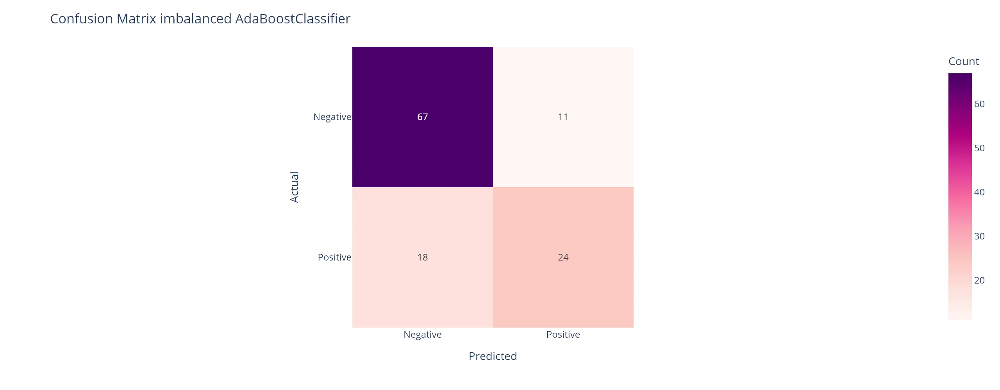


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced CatBoostClassifier model
              precision    recall  f1-score   support

    Negative       0.79      0.92      0.85        78
    Positive       0.79      0.55      0.65        42

    accuracy                           0.79       120
   macro avg       0.79      0.74      0.75       120
weighted avg       0.79      0.79      0.78       120


Below is the confusion matrix for the imbalanced CatBoostClassifier model


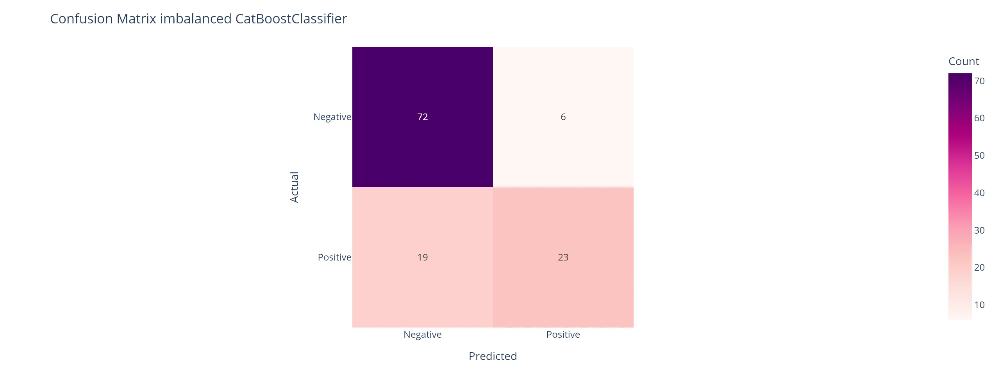


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced DecisionTreeClassifier model
              precision    recall  f1-score   support

    Negative       0.80      0.83      0.82        78
    Positive       0.67      0.62      0.64        42

    accuracy                           0.76       120
   macro avg       0.73      0.73      0.73       120
weighted avg       0.75      0.76      0.76       120


Below is the confusion matrix for the imbalanced DecisionTreeClassifier model


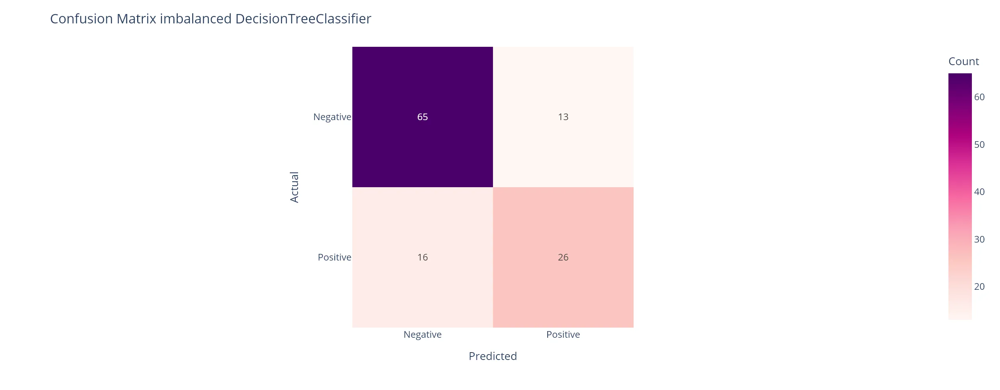


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced KNeighborsClassifier model
              precision    recall  f1-score   support

    Negative       0.72      0.90      0.80        78
    Positive       0.65      0.36      0.46        42

    accuracy                           0.71       120
   macro avg       0.69      0.63      0.63       120
weighted avg       0.70      0.71      0.68       120


Below is the confusion matrix for the imbalanced KNeighborsClassifier model


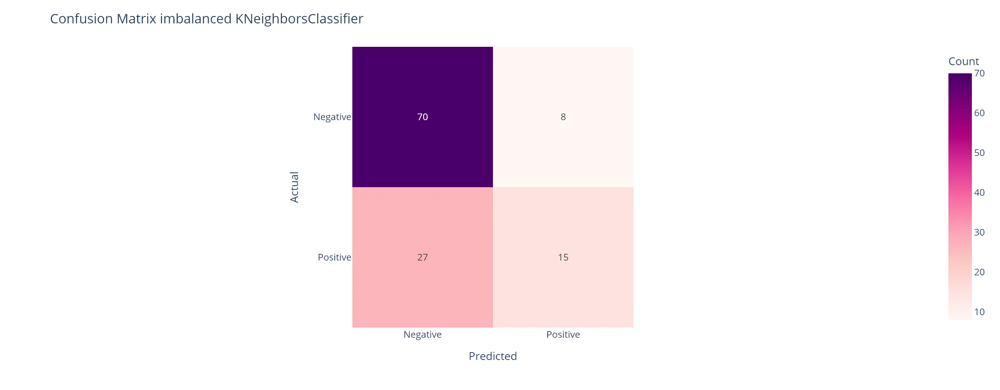


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced LogisticRegression model
              precision    recall  f1-score   support

    Negative       0.76      0.91      0.83        78
    Positive       0.73      0.45      0.56        42

    accuracy                           0.75       120
   macro avg       0.74      0.68      0.69       120
weighted avg       0.75      0.75      0.73       120


Below is the confusion matrix for the imbalanced LogisticRegression model


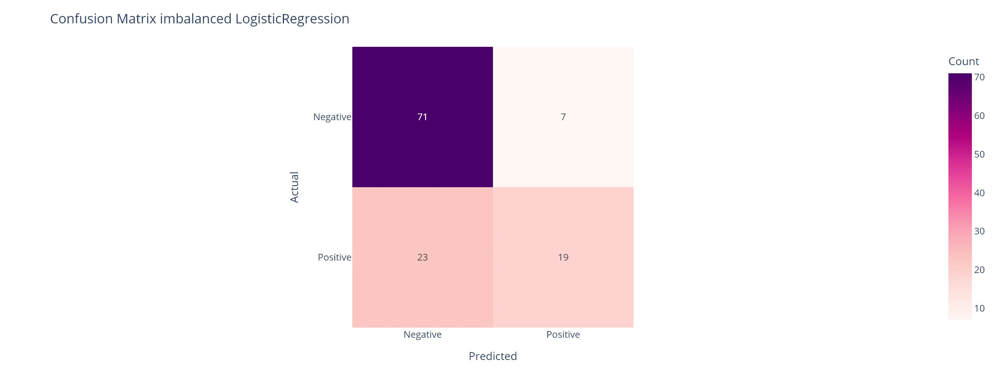


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced RandomForestClassifier model
              precision    recall  f1-score   support

    Negative       0.78      0.94      0.85        78
    Positive       0.81      0.52      0.64        42

    accuracy                           0.79       120
   macro avg       0.80      0.73      0.75       120
weighted avg       0.80      0.79      0.78       120


Below is the confusion matrix for the imbalanced RandomForestClassifier model


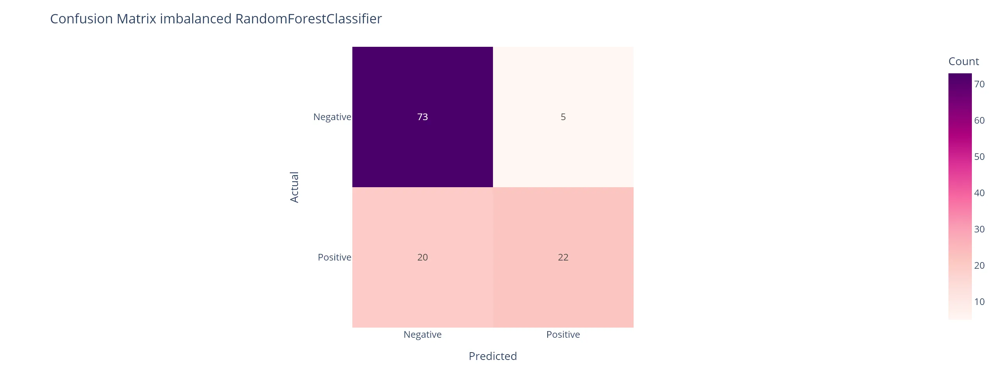


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced SVC model
              precision    recall  f1-score   support

    Negative       0.77      0.92      0.84        78
    Positive       0.77      0.48      0.59        42

    accuracy                           0.77       120
   macro avg       0.77      0.70      0.71       120
weighted avg       0.77      0.77      0.75       120


Below is the confusion matrix for the imbalanced SVC model


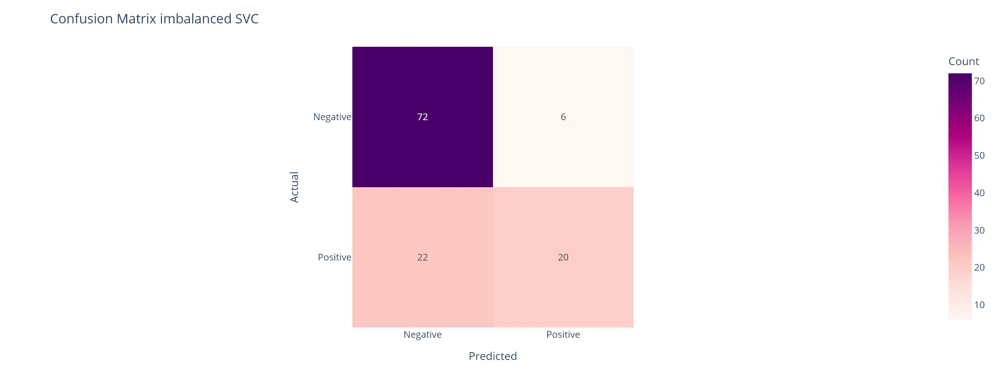


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced XGBClassifier model
              precision    recall  f1-score   support

    Negative       0.80      0.85      0.82        78
    Positive       0.68      0.60      0.63        42

    accuracy                           0.76       120
   macro avg       0.74      0.72      0.73       120
weighted avg       0.75      0.76      0.75       120


Below is the confusion matrix for the imbalanced XGBClassifier model


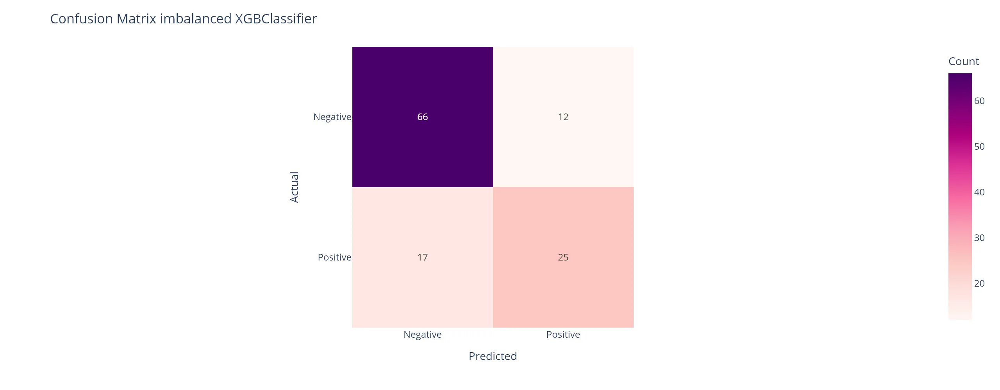


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the imbalanced LGBMClassifier model
              precision    recall  f1-score   support

    Negative       0.78      0.87      0.82        78
    Positive       0.70      0.55      0.61        42

    accuracy                           0.76       120
   macro avg       0.74      0.71      0.72       120
weighted avg       0.75      0.76      0.75       120


Below is the confusion matrix for the imbalanced LGBMClassifier model


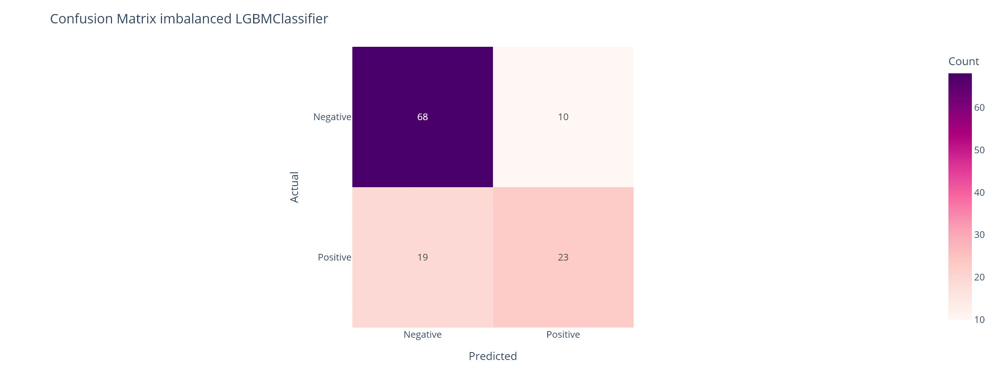


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 


Model evaluation summary report: imbalanced dataset


,accuracy,precision,recall,f1_score
model_name,,,,
CatBoostClassifier,0.79,0.79,0.79,0.78
RandomForestClassifier,0.79,0.80,0.79,0.78
DecisionTreeClassifier,0.76,0.75,0.76,0.76
XGBClassifier,0.76,0.75,0.76,0.75
AdaBoostClassifier,0.76,0.75,0.76,0.75
LGBMClassifier,0.76,0.75,0.76,0.75
SVC,0.77,0.77,0.77,0.75
LogisticRegression,0.75,0.75,0.75,0.73
KNeighborsClassifier,0.71,0.70,0.71,0.68


In [62]:
# Run the function to train models and return performances
models_eval, trained_models = evaluate_models()
models_eval

#### 4.1 Training Models on a Balanced Data Set


This is the classification report of the balanced AdaBoostClassifier model
              precision    recall  f1-score   support

    Negative       0.81      0.76      0.78        78
    Positive       0.60      0.67      0.63        42

    accuracy                           0.72       120
   macro avg       0.70      0.71      0.71       120
weighted avg       0.73      0.72      0.73       120


Below is the confusion matrix for the balanced AdaBoostClassifier model


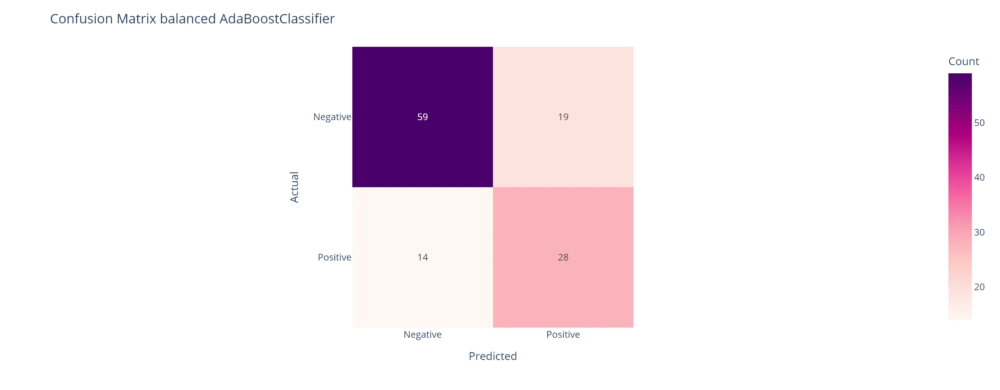


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced CatBoostClassifier model
              precision    recall  f1-score   support

    Negative       0.81      0.85      0.83        78
    Positive       0.69      0.64      0.67        42

    accuracy                           0.78       120
   macro avg       0.75      0.74      0.75       120
weighted avg       0.77      0.78      0.77       120


Below is the confusion matrix for the balanced CatBoostClassifier model


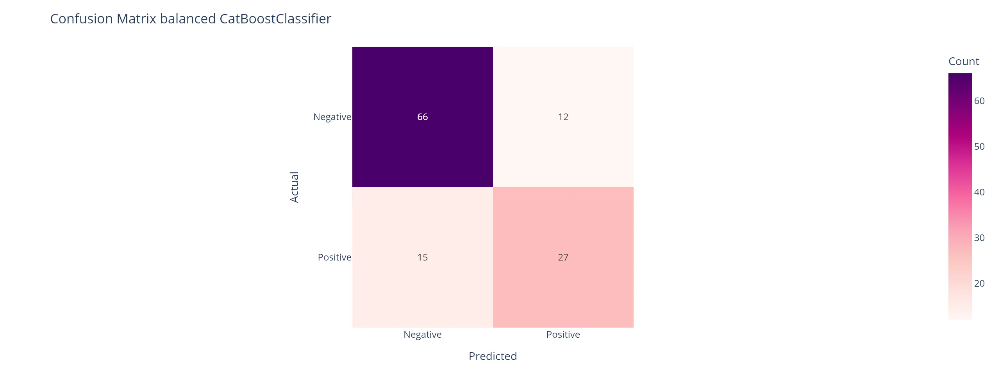


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced DecisionTreeClassifier model
              precision    recall  f1-score   support

    Negative       0.84      0.81      0.82        78
    Positive       0.67      0.71      0.69        42

    accuracy                           0.78       120
   macro avg       0.75      0.76      0.76       120
weighted avg       0.78      0.78      0.78       120


Below is the confusion matrix for the balanced DecisionTreeClassifier model


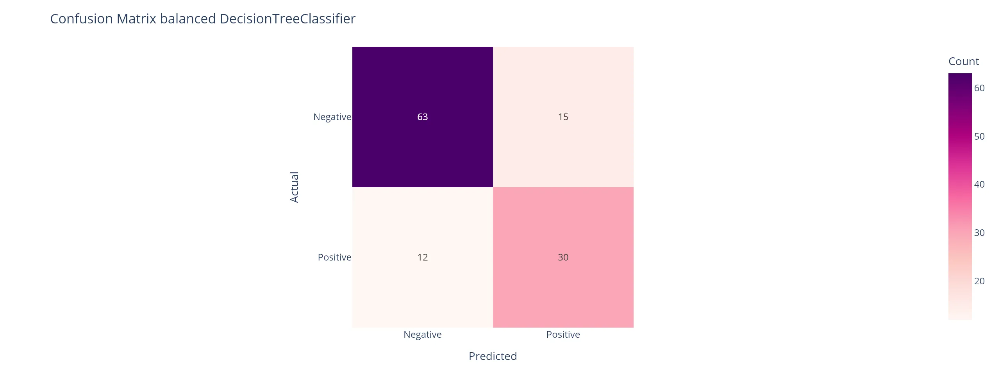


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced KNeighborsClassifier model
              precision    recall  f1-score   support

    Negative       0.81      0.76      0.78        78
    Positive       0.60      0.67      0.63        42

    accuracy                           0.72       120
   macro avg       0.70      0.71      0.71       120
weighted avg       0.73      0.72      0.73       120


Below is the confusion matrix for the balanced KNeighborsClassifier model


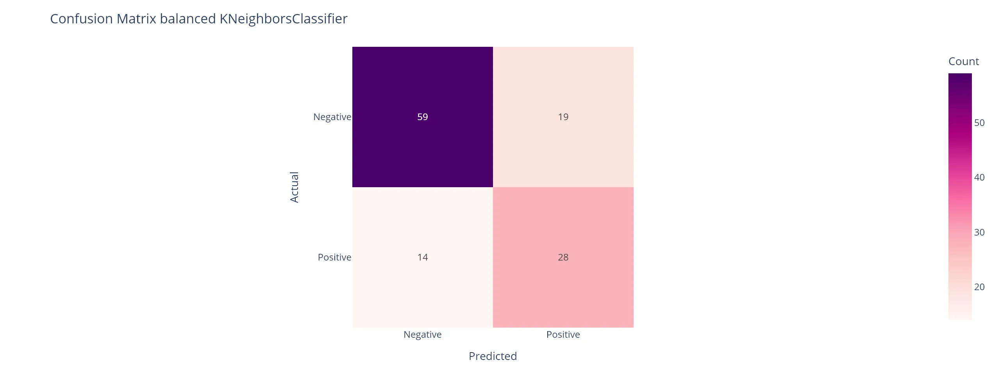


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced LogisticRegression model
              precision    recall  f1-score   support

    Negative       0.83      0.79      0.81        78
    Positive       0.64      0.69      0.67        42

    accuracy                           0.76       120
   macro avg       0.74      0.74      0.74       120
weighted avg       0.76      0.76      0.76       120


Below is the confusion matrix for the balanced LogisticRegression model


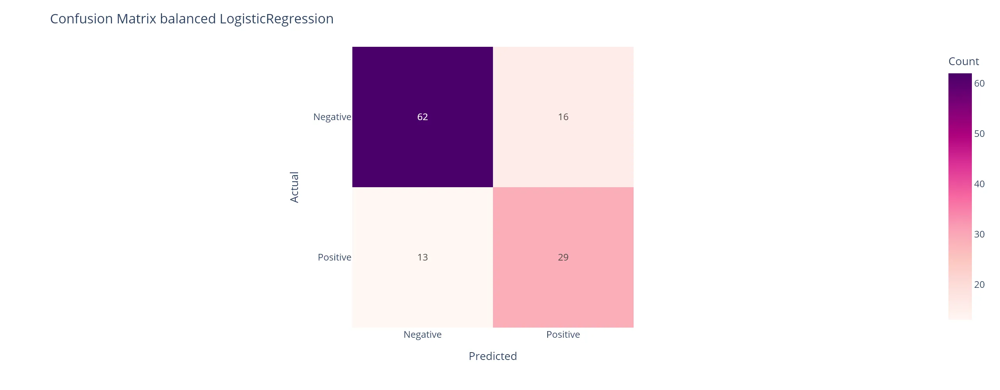


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced RandomForestClassifier model
              precision    recall  f1-score   support

    Negative       0.78      0.83      0.81        78
    Positive       0.65      0.57      0.61        42

    accuracy                           0.74       120
   macro avg       0.72      0.70      0.71       120
weighted avg       0.74      0.74      0.74       120


Below is the confusion matrix for the balanced RandomForestClassifier model


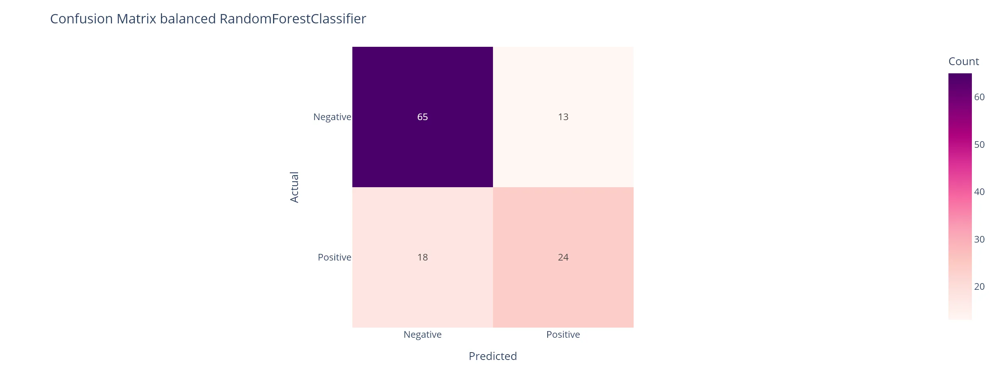


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced SVC model
              precision    recall  f1-score   support

    Negative       0.84      0.74      0.79        78
    Positive       0.61      0.74      0.67        42

    accuracy                           0.74       120
   macro avg       0.72      0.74      0.73       120
weighted avg       0.76      0.74      0.75       120


Below is the confusion matrix for the balanced SVC model


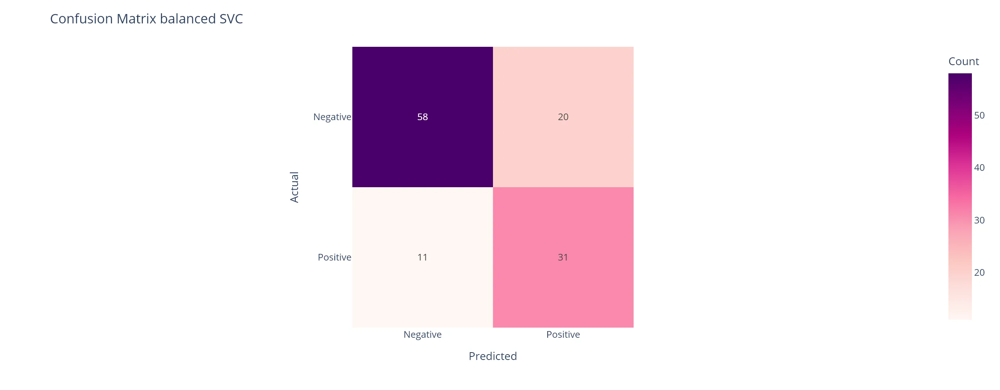


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced XGBClassifier model
              precision    recall  f1-score   support

    Negative       0.79      0.83      0.81        78
    Positive       0.66      0.60      0.62        42

    accuracy                           0.75       120
   macro avg       0.73      0.71      0.72       120
weighted avg       0.75      0.75      0.75       120


Below is the confusion matrix for the balanced XGBClassifier model


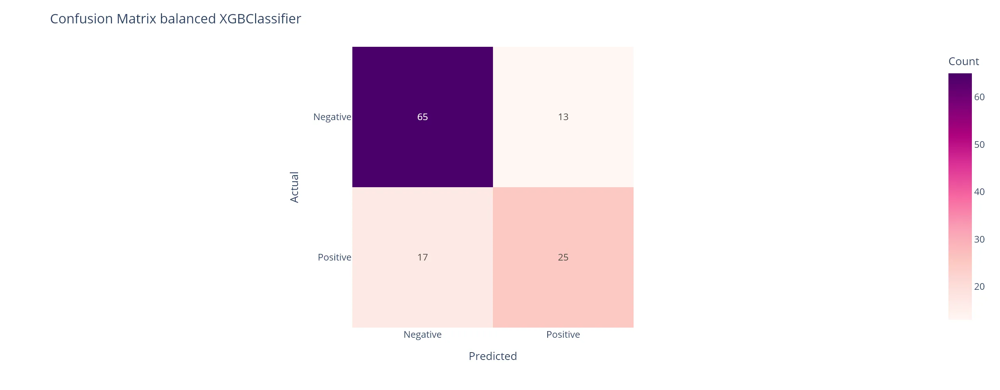


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 

This is the classification report of the balanced LGBMClassifier model
              precision    recall  f1-score   support

    Negative       0.82      0.87      0.84        78
    Positive       0.73      0.64      0.68        42

    accuracy                           0.79       120
   macro avg       0.77      0.76      0.76       120
weighted avg       0.79      0.79      0.79       120


Below is the confusion matrix for the balanced LGBMClassifier model


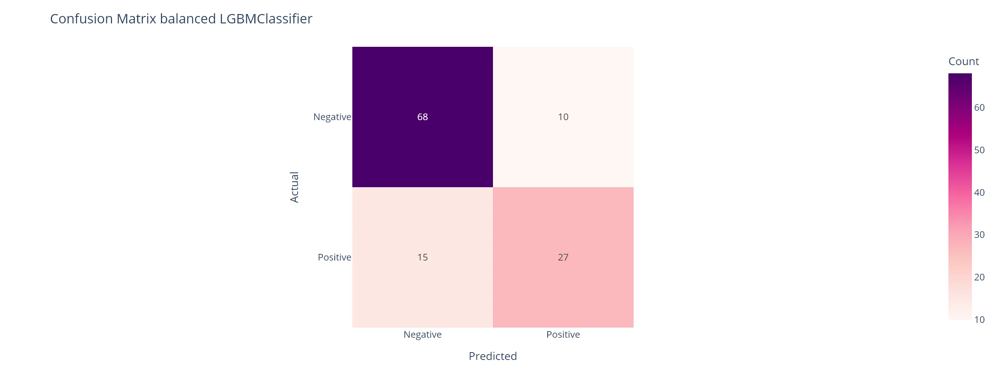


 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 
 -----   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----------   ----- 


Model evaluation summary report: balanced dataset


,accuracy,precision,recall,f1_score
model_name,,,,
LGBMClassifier,0.79,0.79,0.79,0.79
DecisionTreeClassifier,0.78,0.78,0.78,0.78
CatBoostClassifier,0.78,0.77,0.78,0.77
LogisticRegression,0.76,0.76,0.76,0.76
XGBClassifier,0.75,0.75,0.75,0.75
SVC,0.74,0.76,0.74,0.75
RandomForestClassifier,0.74,0.74,0.74,0.74
AdaBoostClassifier,0.72,0.73,0.72,0.73
KNeighborsClassifier,0.72,0.73,0.72,0.73


In [63]:
# Run the function to train models and return performances on a balanced dataset

balanced_models_eval, balanced_trained_models = evaluate_models(balanced=True)
balanced_models_eval

#### 4.2 Compare model evaluation report on imbalanced and balanced dataset


In [64]:
eval_before_after_balance_models = pd.merge(
    models_eval[['accuracy']], 
    balanced_models_eval[['accuracy']], 
    left_index=True, 
    right_index=True,
    how='inner', 
    suffixes=('_before', '_after')
).sort_values(ascending=False, by=['accuracy_before'])

eval_before_after_balance_models

,accuracy_before,accuracy_after
model_name,,
CatBoostClassifier,0.79,0.78
RandomForestClassifier,0.79,0.74
SVC,0.77,0.74
DecisionTreeClassifier,0.76,0.78
XGBClassifier,0.76,0.75
AdaBoostClassifier,0.76,0.72
LGBMClassifier,0.76,0.79
LogisticRegression,0.75,0.76
KNeighborsClassifier,0.71,0.72


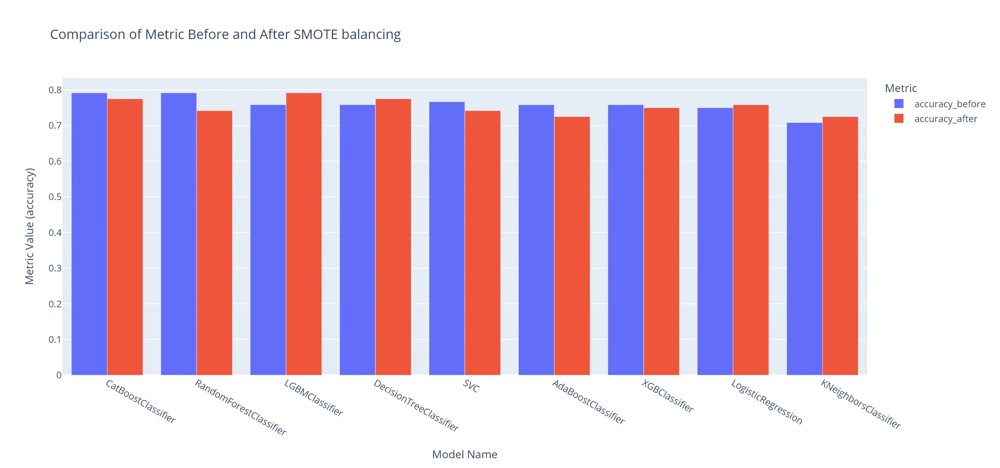

In [65]:
# Melt the dataframe
df_melted_bal = (
    eval_before_after_balance_models
    .reset_index()
    .melt(id_vars='model_name', var_name='metric', value_name='value')
    .sort_values(ascending=False, by=['value'])
)

category_orders = {
    'model_name': df_melted_bal.model_name,
    'metric': ['accuracy_before', 'accuracy_after']
}

# Make the plot
fig = px.bar(
    df_melted_bal,
    x='model_name',
    y='value',        
    color='metric',
    barmode='group',
    title='Comparison of Metric Before and After SMOTE balancing',
    labels={'value': 'Metric Value (accuracy)', 'model_name': 'Model Name', 'metric': 'Metric'},
    category_orders=category_orders,
    orientation='v',
    height=600
)

# Show plot
show_plot(fig)

## 4.3 Hyperparameter tuning- GridSearch
### 4.3.1 Define hyperparameters to search

In [66]:
# Define the hyperparameters to search

param_grids = {
    0: { # ada_boost
        'classifier__n_estimators': [10, 50, 100],
        'classifier__learning_rate':  [0.1, 0.5, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R'],        
    },
    1: { # cat_boost
        'classifier__n_estimators': [10, 50, 100],
        'classifier__learning_rate':  [0.1, 0.5, 1],        
    },
    2: { # decision_tree
        'classifier__max_depth': [None, 10, 20, 30, 50],
        'classifier__min_samples_split': [2, 5, 10, 20],        
    },
    3: { # knn
        'classifier__n_neighbors': [3, 5, 7, 9, 11, 20],
        'classifier__leaf_size': [20, 30, 40, 50],         
    },
    4: { # log_regression
        'classifier__C': [0.1, 1, 10, 20],
        'classifier__solver' : ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
        'classifier__max_iter': [100, 200, 300, 500]       
    },
    5: { # random_forest
        'classifier__n_estimators': [10, 50, 100],
        'classifier__max_depth': [None, 10, 20, 30],
    },
    6: { # svm
        'classifier__C': [0.1, 1, 10, 20],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid', 'precomputed'],
        'classifier__decision_function_shape': ['ovo', 'ovr'],        
    },
    7: { # xgb
        'classifier__n_estimators': [10, 50, 100],
        'classifier__max_depth': [5, 10, 20, 30],              
    },
    8: { # lgb
        'classifier__num_leaves': [20, 40, 60],
        'classifier__n_estimators': [10, 50, 100],
        'classifier__max_depth': [3, 5, 10],               
    }    
}

param_grids= {models[k].__class__.__name__: v for k, v in param_grids.items()}
param_grids.keys()

dict_keys(['AdaBoostClassifier', 'CatBoostClassifier', 'DecisionTreeClassifier', 'KNeighborsClassifier', 'LogisticRegression', 'RandomForestClassifier', 'SVC', 'XGBClassifier', 'LGBMClassifier'])

### 4.3.2 Cross validating and Tuning models with the hyperparameters

In [67]:
params = {}
search_histories = {}

for model in models:
    final_pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('feature-selection', SelectKBest(mutual_info_classif, k='all')),
        ('classifier', model)
    ])

    model_name = model.__class__.__name__
    
    param_grid = param_grids[model_name]
    
    # Create a StratifiedKFold object
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=random_state)
    
    searcher = GridSearchCV(
        estimator = final_pipeline,
        param_grid = param_grid,
        cv = skf, # StratifiedKFold for imbalanced dataset
        scoring = 'f1_weighted',
        verbose = 3, # verbose=3 # Show the steps as output
        n_jobs = -1        
    )
    
    searcher.fit(X_train, y_train_encoded)
    search_history = pd.DataFrame(searcher.cv_results_)    
    params[model_name] = searcher
    search_histories[model_name] = search_history

for model_name, search in params.items():
    print(f'Best hyperparamters for {model_name}:{search.best_params_}')

Fitting 5 folds for each of 18 candidates, totalling 90 fits
Fitting 5 folds for each of 9 candidates, totalling 45 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Fitting 5 folds for each of 96 candidates, totalling 480 fits
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Fitting 5 folds for each of 40 candidates, totalling 200 fits
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparamters for AdaBoostClassifier:{'classifier__algorithm': 'SAMME.R', 'classifier__learning_rate': 0.5, 'classifier__n_estimators': 50}
Best hyperparamters for CatBoostClassifier:{'classifier__learning_rate': 0.1, 'classifier__n_estimators': 50}
Best hyperparamters for DecisionTreeClassifier:{'classifier__max_depth': 10, 'classifier__min_samples_split': 5}
Best hyperparamters for KNeighborsClassifier:{'classifier__leaf_size': 20, 'cl

### 4.3.3 Get the performance of each model with the best hyperparameters

In [68]:
def get_best_models(params):
    best_models_metrics = pd.DataFrame(columns=['model_name', 'accuracy', 'precision', 'recall', 'f1_score'])

    best_models = {}
    
    for model_name, search in params.items():
        best_model = search.best_estimator_
        best_models[model_name] = best_model
        
        # Make predictions with the tuned model
        y_pred = best_model.predict(X_eval)

        # Store classification report values as a dictionary
        metric = classification_report(y_eval_encoded, y_pred, output_dict=True)

        #Grab values from the balanced metric dictionary
        accuracy = metric['accuracy']
        precision = metric['weighted avg']['precision']
        recall  = metric['weighted avg']['recall']
        f1_score =  metric['weighted avg']['f1-score']

        #Add these values to the table
        best_models_metrics.loc[len(best_models_metrics)] = [model_name, precision, recall, accuracy, f1_score]
        
    best_models_metrics.set_index('model_name', inplace=True)
    return best_models, best_models_metrics
 
best_models, best_models_metrics = get_best_models(params)

In [69]:
best_models_metrics.sort_values(by='f1_score', ascending=False, inplace=True)
best_models_metrics

,accuracy,precision,recall,f1_score
model_name,,,,
RandomForestClassifier,0.80,0.79,0.79,0.78
XGBClassifier,0.78,0.78,0.78,0.78
CatBoostClassifier,0.76,0.77,0.77,0.75
SVC,0.77,0.77,0.77,0.75
AdaBoostClassifier,0.75,0.76,0.76,0.75
LGBMClassifier,0.74,0.75,0.75,0.74
DecisionTreeClassifier,0.73,0.74,0.74,0.74
LogisticRegression,0.74,0.74,0.74,0.72
KNeighborsClassifier,0.70,0.71,0.71,0.70


### 4.3.4 Comparing models using best hyperparameters from GridSearch CV

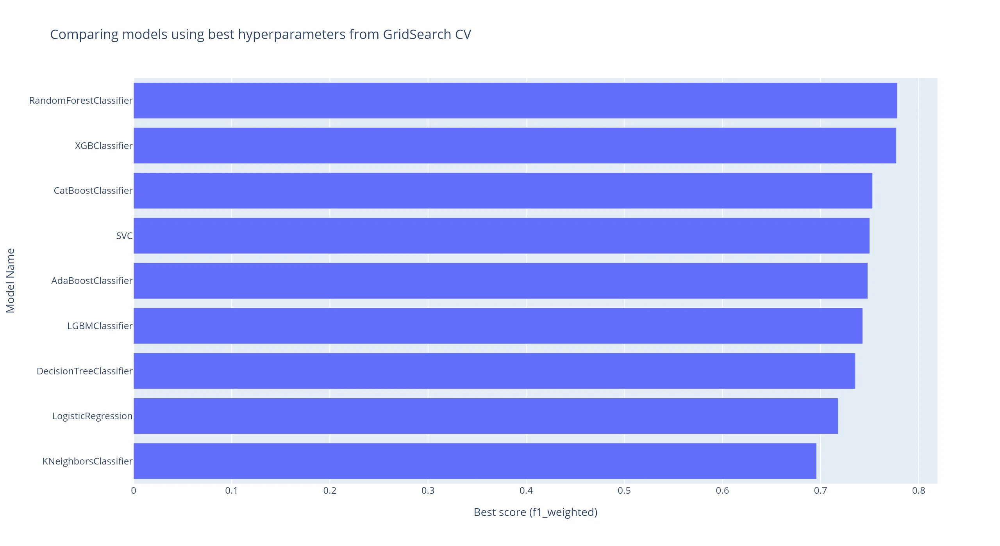

In [70]:
fig = px.bar(
    best_models_metrics.sort_values(by='f1_score', ascending=True), x='f1_score',  
    labels={'f1_score': 'Best score (f1_weighted)', 'model_name': 'Model Name'},
    title='Comparing models using best hyperparameters from GridSearch CV',
    orientation='h', 
    height=700
)

# Show the plot
show_plot(fig)

### 4.3.5 Compare models before and after hyperparameter tuning using f1 score (weighted) metric


In [71]:
metric_before_after_tuning_models = pd.merge(
    models_eval[['f1_score']], 
    best_models_metrics[['f1_score']], 
    left_index=True, 
    right_index=True,
    how='inner', 
    suffixes=('_before', '_after')
).sort_values(ascending=False, by='f1_score_after')

metric_before_after_tuning_models

,f1_score_before,f1_score_after
model_name,,
RandomForestClassifier,0.78,0.78
XGBClassifier,0.75,0.78
CatBoostClassifier,0.78,0.75
SVC,0.75,0.75
AdaBoostClassifier,0.75,0.75
LGBMClassifier,0.75,0.74
DecisionTreeClassifier,0.76,0.74
LogisticRegression,0.73,0.72
KNeighborsClassifier,0.68,0.70


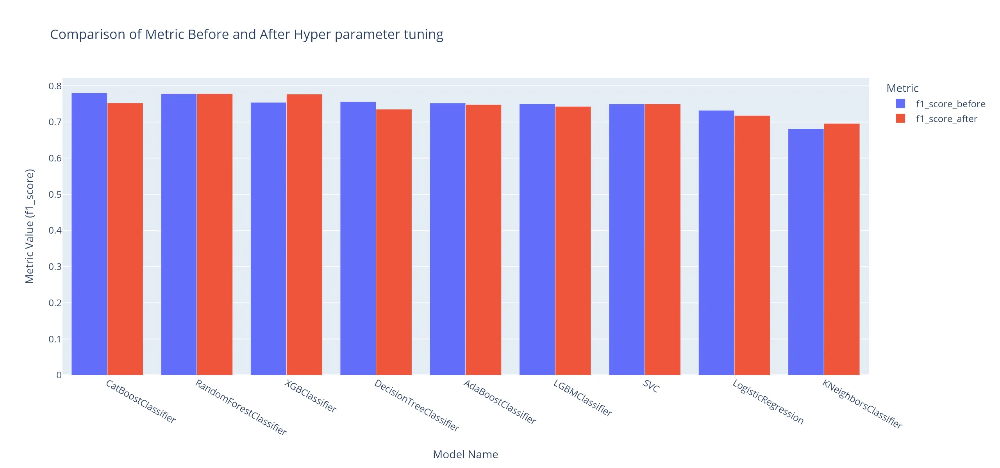

In [72]:
# Melt the dataframe
df_melted_tuning = (
    metric_before_after_tuning_models.reset_index()
    .melt(id_vars='model_name', var_name='metric', value_name='value')
    .sort_values(ascending=False, by=['value'])
)

category_orders = {
    'model_name': df_melted_tuning.model_name,
    'metric':['f1_score_before', 'f1_score_after']
}

# Make the plot
fig = px.bar(
    df_melted_tuning,
    x='model_name',
    y='value',        
    color='metric',    
    barmode='group',
    title='Comparison of Metric Before and After Hyper parameter tuning',
    labels={'value': f'Metric Value ({metric.__name__})', 'model_name': 'Model Name', 'metric': 'Metric'},
    category_orders=category_orders,
    orientation='v',
    height=600
)

# Show plot
show_plot(fig)

### 4.3.6  Plot the ROC-AUC Curve for all models

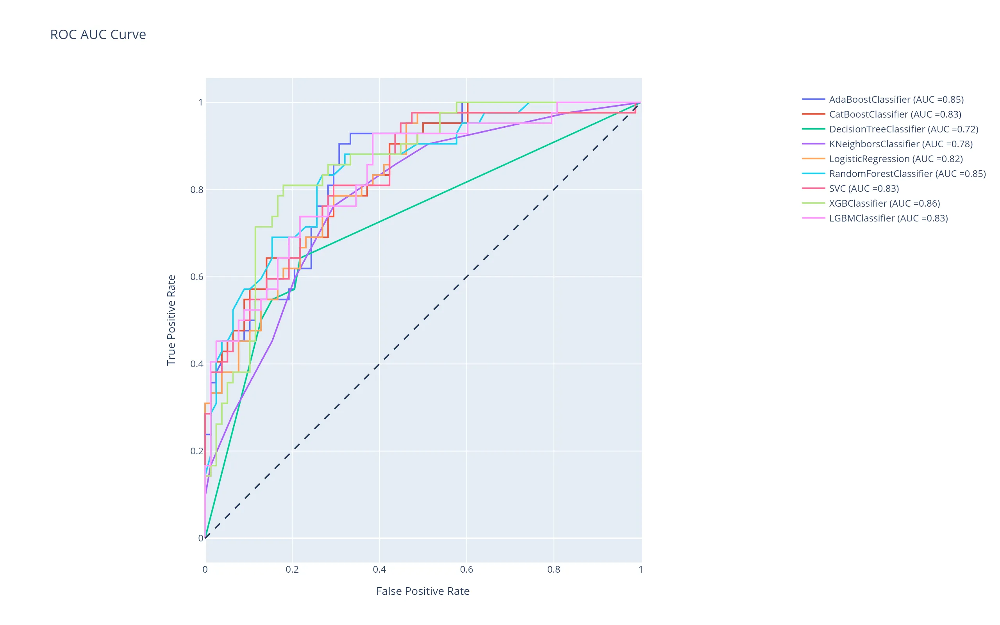

In [73]:
fig = go.Figure()

# Add confusion matrix to all pipelines
all_confusion_matrix = {}

# Add ROC data for all pipelines
all_roc_data = {}

for model_name, pipeline in best_models.items():
    y_score = pipeline.predict_proba(X_eval)[:, 1]
    
    fpr, tpr, thresholds = roc_curve(y_eval_encoded, y_score)

    roc_auc = auc(fpr, tpr)

    roc_data_df = pd.DataFrame({'False Positive rate': fpr, 'True Positive Rate': tpr, 'Thresholds': thresholds})

    all_roc_data[model_name] = roc_data_df
        

    # Generate the confusion matrix
    y_pred = pipeline.predict(X_eval)
    
    conf_matrix = confusion_matrix(y_eval_encoded, y_pred)
    
    all_confusion_matrix[model_name] = conf_matrix

    fig = fig.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines', name=f'{model_name} (AUC ={roc_auc:.2f})'))           

    fig = fig.update_layout(
        title=f'ROC AUC Curve',
        xaxis_title='False Positive Rate',
        yaxis_title='True Positive Rate',
        legend=dict(
            x=1.02,
            y=0.98
        ), 
        yaxis=dict(scaleanchor="x", scaleratio=1),
        xaxis=dict(constrain='domain'),                    
        height=800
)

fig = fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)


show_plot(fig)

### 4.3.7.1 Get the best two model pipelines


In [74]:
def get_model_by_rank(rank: int, best_models_metrics: pd.DataFrame, best_models: Dict[Pipeline, imPipeline], metric):
    mask = best_models_metrics[metric.__name__] == best_models_metrics[metric.__name__].nlargest(rank).iloc[rank-1]
    rank_model_metric = best_models_metrics[mask]
    rank_model_name = rank_model_metric.index[0]
    model = best_models[rank_model_name]
    return model, rank_model_name, rank_model_metric

In [75]:
best_model, best_model_name, best_model_metric = get_model_by_rank(1, best_models_metrics, best_models, metric)
best_model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numerical_pipeline',
                                                  Pipeline(steps=[('log_transformations',
                                                                   FunctionTransformer(func=<ufunc 'log1p'>)),
                                                                  ('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   RobustScaler())]),
                                                  ['prg', 'pl', 'pr', 'sk',
                                                   'ts', 'm11', 'bd2', 'age']),
                                                 ('categorical_pipeline',
                                                  Pipeline(steps=[('as_categorical',
                                                                   Funct...
                                                                   FunctionTransformer(func=<function feature_creation at 0x0000013CE41B7C40>)),
                                                                  ('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  ['age'])])),
                ('feature-selection',
                 SelectKBest(k='all',
                             score_func=<function mutual_info_classif at 0x0000013CE4234F40>)),
                ('classifier',
                 RandomForestClassifier(n_jobs=-1, random_state=2024))])

In [76]:
# Display the best model
print(f"The best model is: {best_model_name}")

The best model is: RandomForestClassifier


In [77]:
second_best_model, second_best_model_name, second_best_model_metric  = get_model_by_rank(2, best_models_metrics, best_models, metric)
second_best_model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numerical_pipeline',
                                                  Pipeline(steps=[('log_transformations',
                                                                   FunctionTransformer(func=<ufunc 'log1p'>)),
                                                                  ('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   RobustScaler())]),
                                                  ['prg', 'pl', 'pr', 'sk',
                                                   'ts', 'm11', 'bd2', 'age']),
                                                 ('categorical_pipeline',
                                                  Pipeline(steps=[('as_categorical',
                                                                   Funct...
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=20, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=10, n_jobs=-1,
                               num_parallel_tree=None, random_state=2024, ...))])

In [78]:
# Display the second best model
print(f"The second best model is: {second_best_model_name}")

The second best model is: XGBClassifier


### 4.3.7.2  Plot the ROC-AUC Curve for the best two models

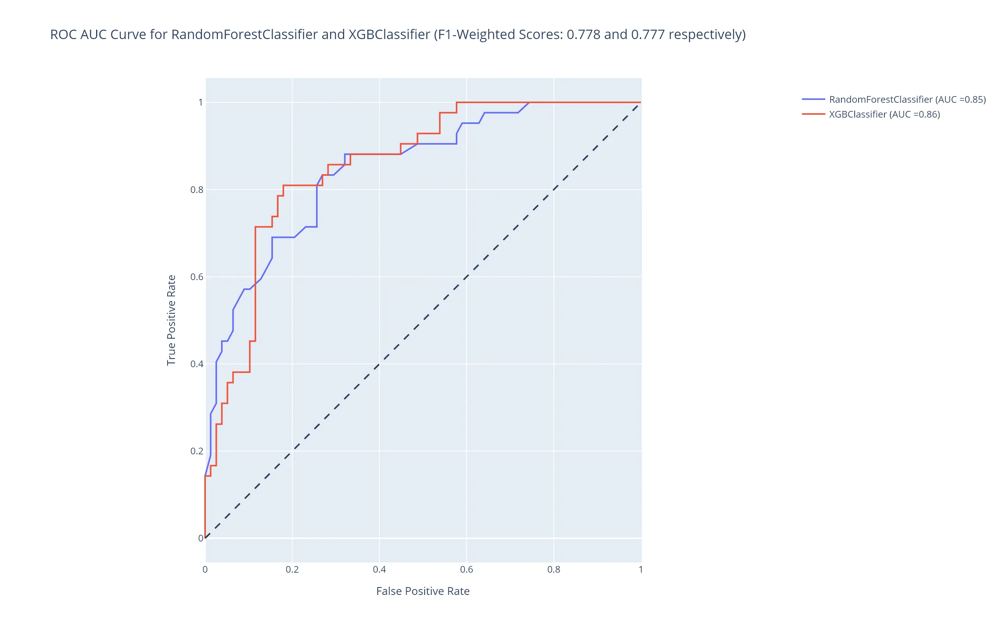

In [79]:
fig = go.Figure()

for pipeline, model_name in [(best_model, best_model_name), (second_best_model, second_best_model_name)]:
    y_score = pipeline.predict_proba(X_eval)[:, 1]
    
    fpr, tpr, thresholds = roc_curve(y_eval_encoded, y_score)

    roc_auc = auc(fpr, tpr)

    fig = fig.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines', name=f'{model_name} (AUC ={roc_auc:.2f})'))           


best_model_f1 = round(best_model_metric[metric.__name__].iloc[0], 3)
second_best_model_f1 = round(second_best_model_metric[metric.__name__].iloc[0], 3)
fig = fig.update_layout(
    title=f"ROC AUC Curve for {best_model_name} and {second_best_model_name} (F1-Weighted Scores: {best_model_f1} and {second_best_model_f1} respectively)",
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    legend=dict(
        x=1.02,
        y=0.98
    ), 
    yaxis=dict(scaleanchor="x", scaleratio=1),
    xaxis=dict(constrain='domain'),                    
    height=800
)

best_two_roc_fig = fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

show_plot(best_two_roc_fig)

### 4.3.7.3 Feature importances of the best model and second best model


In [80]:
def display_feature_importances(pipeline: Union[Pipeline|imPipeline], new_features: List[str], f1: str):
    # Get the numerical feature names after transformation
    numerical_features_transformed = pipeline.named_steps['preprocessor'].named_transformers_['numerical_pipeline'].named_steps['scaler'].get_feature_names_out(numerical_features)
    
    # Get the categorical feature names after transformation
    categorical_features_transformed = pipeline.named_steps['preprocessor'].named_transformers_['categorical_pipeline'].named_steps['encoder'].get_feature_names_out(categorical_features)
    
    # Get the created feature names after transformation
    created_features_transformed = pipeline.named_steps['preprocessor'].named_transformers_['feature_creation_pipeline'].named_steps['encoder'].get_feature_names_out(new_features)
    
    # Get the feature names after transformation
    feature_columns = np.concatenate((numerical_features_transformed, categorical_features_transformed, created_features_transformed))
    
    importances_scores = pipeline.named_steps['classifier'].feature_importances_

    importances_df = pd.DataFrame({'feature': feature_columns, 'score': importances_scores})

    # Magnitude of impact
    importances_df.sort_values(by="score", ascending=True, inplace=True)
    
    # Create a horizontal bar chart using Plotly Express
    fig = px.bar(
        importances_df, 
        x='score', 
        y='feature', 
        orientation='h',  # Set orientation to horizontal
        title=f"Feature Importances- {pipeline['classifier'].__class__.__name__} (F1-Weighted Scores: {f1})",
        labels={'Score': 'Score', 'Feature': 'feature'},
        height=700,
        color='score'      
    )
    
    # Show the plot
    show_plot(fig)
    
    return fig

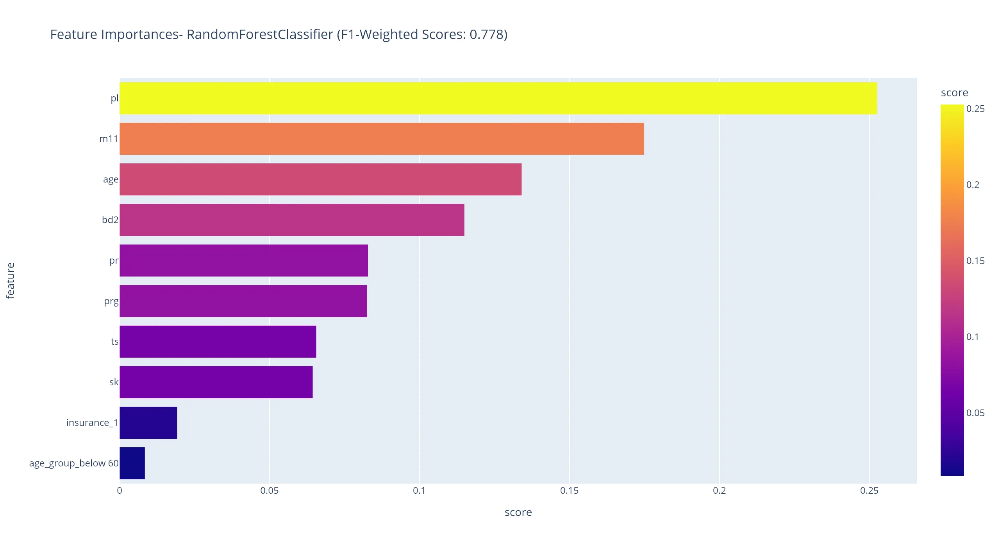

In [81]:
best_model_imp_fig = display_feature_importances(best_model, new_features, f1=best_model_f1)

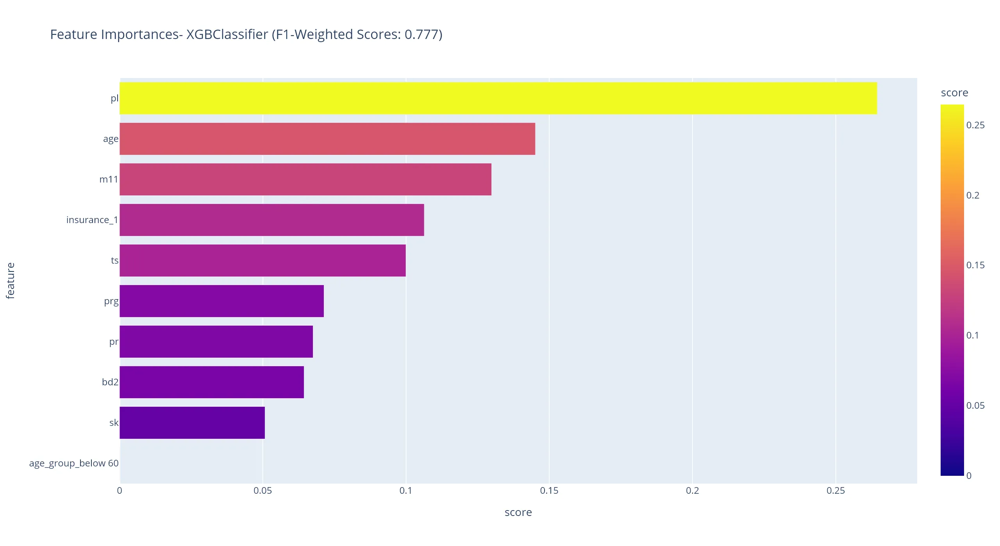

In [82]:
second_best_model_imp_fig = display_feature_importances(second_best_model, new_features, f1=second_best_model_f1)

### 4.4 Use the best two models to predict on unknown dataset (df_test)


In [83]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169 entries, 0 to 168
Data columns (total 10 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   id         169 non-null    object 
 1   prg        169 non-null    int64  
 2   pl         169 non-null    int64  
 3   pr         169 non-null    int64  
 4   sk         169 non-null    int64  
 5   ts         169 non-null    int64  
 6   m11        169 non-null    float64
 7   bd2        169 non-null    float64
 8   age        169 non-null    int64  
 9   insurance  169 non-null    int64  
dtypes: float64(2), int64(7), object(1)
memory usage: 13.3+ KB


In [84]:
predicted_sepsis = {}

predicted_sepsis[best_model_name] = best_model.predict(df_test)
predicted_sepsis[second_best_model_name] = second_best_model.predict(df_test)

predicted_sepsis

{'RandomForestClassifier': array([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1,
        0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0,
        1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0]),
 'XGBClassifier': array([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1,
        0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0,
        0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1,
        0, 1, 

In [85]:
# Create predicted sepsis classification for the best two models
df_test_prediction = df_test.copy()

for model_name, prediction in predicted_sepsis.items():
    column_name = 'sepsis_by_' + model_name.lower()
    df_test_prediction[column_name] = encoder.inverse_transform(prediction)
    
df_test_prediction.head()

,id,prg,pl,pr,sk,ts,m11,bd2,age,insurance,sepsis_by_randomforestclassifier,sepsis_by_xgbclassifier
0,ICU200609,1,109,38,18,120,23.10,0.41,26,1,Negative,Negative
1,ICU200610,1,108,88,19,0,27.10,0.40,24,1,Negative,Negative
2,ICU200611,6,96,0,0,0,23.70,0.19,28,1,Negative,Negative
3,ICU200612,1,124,74,36,0,27.80,0.10,30,1,Negative,Negative
4,ICU200613,7,150,78,29,126,35.20,0.69,54,0,Positive,Positive


### 4.4.1 Visualize the predictions


In [86]:
df_test_prediction.describe(include='all')

,id,prg,pl,pr,sk,ts,m11,bd2,age,insurance,sepsis_by_randomforestclassifier,sepsis_by_xgbclassifier
count,169,169.00,169.00,169.00,169.00,169.00,169.00,169.00,169.00,169.00,169,169
unique,169,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,2
top,ICU200609,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Negative,Negative
freq,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,123,120
mean,NaN,3.92,123.52,70.43,20.44,81.00,32.25,0.44,33.07,0.73,NaN,NaN
std,NaN,3.40,29.26,19.43,15.76,110.72,7.44,0.31,11.55,0.45,NaN,NaN
min,NaN,0.00,56.00,0.00,0.00,0.00,0.00,0.10,21.00,0.00,NaN,NaN
25%,NaN,1.00,102.00,62.00,0.00,0.00,27.60,0.22,24.00,0.00,NaN,NaN
50%,NaN,3.00,120.00,74.00,23.00,0.00,32.40,0.34,28.00,1.00,NaN,NaN
75%,NaN,6.00,141.00,80.00,32.00,135.00,36.60,0.59,42.00,1.00,NaN,NaN


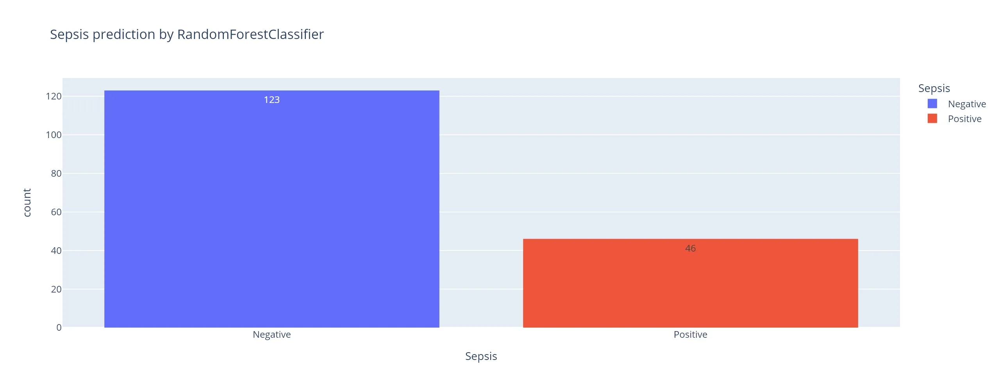

In [87]:
fig = px.histogram(
    df_test_prediction.rename(columns={'sepsis_by_randomforestclassifier': 'sepsis'}), x='sepsis', 
    title=f"Sepsis prediction by {best_model_name}", 
    color='sepsis', 
    category_orders={'sepsis': ['Negative', 'Positive']},
    labels={'sepsis': 'Sepsis'},
)

# Update the layout to add count values on top of each bar
fig.update_traces(texttemplate='%{y}', textposition='inside')

# Show the plot
show_plot(fig)

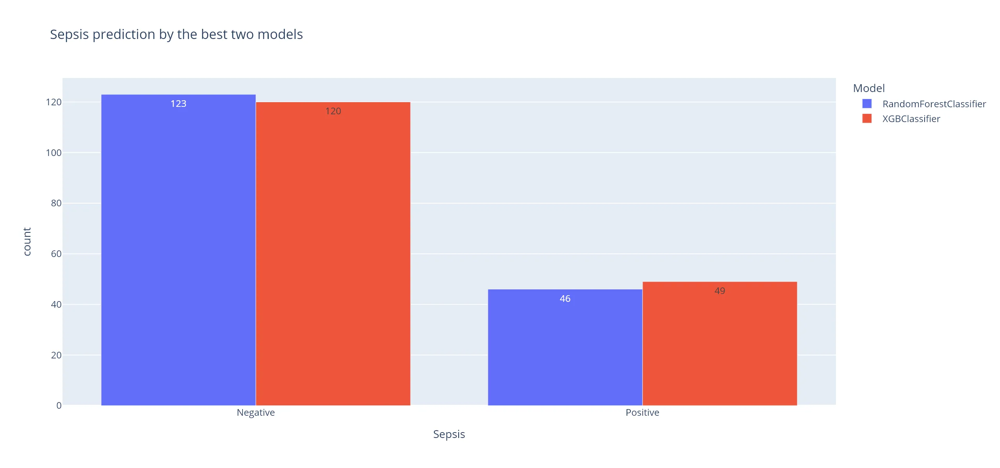

In [88]:
# Melt the dataframe
df_melted_pred = (
    df_test_prediction[['sepsis_by_randomforestclassifier', 'sepsis_by_xgbclassifier']]
    .rename(columns={'sepsis_by_randomforestclassifier': best_model_name, 'sepsis_by_xgbclassifier': second_best_model_name})
    .melt()
    .rename(columns={'variable': 'model', 'value': 'sepsis'})
    .groupby(['sepsis', 'model'])['sepsis']
    .count()
    .to_frame()
    .rename(columns={'sepsis': 'count'})
    .reset_index()
)

category_orders = {
    'model': df_melted_pred.model.unique(),
    'sepsis': ['Negative', 'Positive']
}

# Make the plot
fig = px.bar(
    df_melted_pred,
    x='sepsis',
    y='count',  
    text='count',
    color='model',    
    barmode='group',
    title='Sepsis prediction by the best two models',
    labels={'sepsis': 'Sepsis', 'model': 'Model'},
    category_orders=category_orders,
    orientation='v',
    height=600
)

# Show the plot
show_plot(fig)

### 4.5 Persist the models 💾

In [89]:
def path_maker(filename: str, path: str) -> str:
    '''
    Creates a file path by combining the given directory and filename.
    If the directory does not exist, it is created.

    Parameters:
    filename (str): The name of the file.
    path (str): The path to the directory where the file should be located.

    Returns:
    str: The full path to the file.
    '''
    if not os.path.exists(path):
        os.makedirs(path)
        
    file_path = os.path.join(path, filename) 
    
    return file_path  

#### 4.5.1 Using Joblib

In [90]:
# Models
compdir = SAVE_MODELS
for model_name, pipeline in best_models.items():
    filename = f'{model_name}.joblib'
    filepath = path_maker(filename, compdir)
    joblib.dump(pipeline, filepath)

# Encoder
compdir = SAVE_MODELS+'enc'
filename = 'encoder.joblib'
filepath = path_maker(filename, compdir)
joblib.dump(encoder, filepath)

# External pipeline functions
compdir = SAVE_MODELS+'pipeline_func'
pipeline_functions = {'as_category': as_category, 'feature_creation': feature_creation}
filename = 'pipeline_functions.joblib'
filepath = path_maker(filename, compdir)
joblib.dump(pipeline_functions, filepath)

print('💾 All models, encoder, and pipeline functions have been saved.')

💾 All models, encoder, and pipeline functions have been saved.


#### 4.5.2 Using HuggingFace

#### 4.5.2.1 Login to HuggingFace and save token

In [91]:
notebook_login(write_permission=True)

#### 4.5.2.2 Read the token file

In [92]:
with open(TOKEN_FILE, 'r') as file:
    token = file.read()

#### 4.5.2.3 Push the best two models to HuggingFace

In [93]:
def push_to_huggingface(model_name: str, imp_fig, data: pd.DataFrame = df_train, token: str = token):
    model_fp = SAVE_MODELS + f'{model_name}.joblib'
    huggingface_fd = SAVE_MODELS + f'huggingface/{model_name}/' 
    _ = path_maker('', huggingface_fd)
    
    hub_utils.init(
        model=model_fp, 
        dst=huggingface_fd, 
        requirements=['scikit-learn=1.5.0', 'imbalanced-learn=0.12.3'], 
        task='tabular-classification', 
        data=data
    )
    
    
    model_card = card.Card(
        model_fp, 
        metadata=card.metadata_from_config(Path(huggingface_fd))
    )

    github_link = "https://github.com/D0nG4667/sepsis_prediction_full_stack"
    kaggle_link = "https://www.kaggle.com/datasets/chaunguynnghunh/sepsis/data"
    description = f"This is a {model_name} model trained on Sepsis dataset from this [kaggle dataset]({kaggle_link})."
    limitations = f"This model needs further feature engineering to improve the f1 weighted score. Collaborate on with me here [GitHub]({github_link})"
    authors = "Gabriel Okundaye"
    get_started = f"import joblib \n clf = joblib.load({model_fp})"
    citation_bibtex = "bibtex\n@inproceedings{...,year={2024}}"
    model_card.add(
        citation_bibtex=citation_bibtex,
        get_started_code=get_started,
        model_card_authors=authors,
        limitations=limitations,
        model_description=description,
    )
    model_card.metadata.license = "mit"

    best_two_roc_fp = show_plot(best_two_roc_fig, save_only=True, save_dir=huggingface_fd, interactive=False)
    imp_fig_fp = show_plot(imp_fig, save_only=True, save_dir=huggingface_fd, interactive=False)

    model_card.add_plot(roc_auc_curve=best_two_roc_fp.removeprefix(huggingface_fd))
    model_card.add_plot(feature_importances=imp_fig_fp.removeprefix(huggingface_fd))

    model_card.save(Path(huggingface_fd) / "README.md")

        
    # If the repository doesn't exist remotely on the Hugging Face Hub, it will be created when we set create_remote to True
    repo_id = f"gabcares/{model_name}-Sepsis"
    hub_utils.push(
        repo_id=repo_id,
        source=huggingface_fd,
        token=token,
        commit_message=f"Pushing files to the repo-{repo_id} from the directory- {huggingface_fd}",
        create_remote=True,
    )  
    
    return repo_id  

In [94]:
best_model_repo_id = push_to_huggingface(model_name=best_model_name, imp_fig=best_model_imp_fig)

RandomForestClassifier.joblib:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

In [95]:
second_best_model_repo_id =  push_to_huggingface(model_name=second_best_model_name, imp_fig=second_best_model_imp_fig)

XGBClassifier.joblib:   0%|          | 0.00/44.8k [00:00<?, ?B/s]

#### 4.5.2.4 How to download model from HuggingFace

In [96]:
# How to download model from HuggingFace
download_repo = SAVE_MODELS + f'huggingface/downloaded_model/{best_model_name}/' 
_ = path_maker('', download_repo)
hub_utils.download(repo_id=best_model_repo_id, dst=download_repo)


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

(…)ores__0.778_and_0.777_respectively).webp:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

README.md:   0%|          | 0.00/73.3k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.76k [00:00<?, ?B/s]

(…)ssifier_(F1-Weighted_Scores__0.778).webp:   0%|          | 0.00/30.7k [00:00<?, ?B/s]

RandomForestClassifier.joblib:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

Made with 💖 [Gabriel Okundaye](https://www.linkedin.com/in/dr-gabriel-okundaye)
<span style="color: #aaaaaa;">& Light ✨</span>